# **Exploratory Data Analysis**

Kelompok Woro Wiri (Kyuubi Kelompok 9):
1. Apridian Saputra
2. Sikah Nubuahtul Ilmi
3. Lois Noval E. Gurning
4. Sakti Mujahid
5. Joshia

**Notebook ini akan menunjukkan**:
- Gambaran dataset multimodal (Audio, Lyrics, MIDI)
- Analisis Intra-Modal per modalitas
- Analisis Inter-Modal (korelasi antar modalitas)
- Analisis Target/Label (distribusi kelas & potensi imbalance)
- Visualisasi fitur berdimensi tinggi ke 2D (PCA, UMAP, t-SNE)
- Identifikasi masalah data (missing, rusak, misalignment) & rencana tindak lanjut

> **Catatan:** Banyak bagian narasi bertanda *dummy* supaya bisa diisi setelah plot muncul.

## Install Library/Dependensi dan Download Dataset

In [ ]:
# =========================
# STEP 1 — SETUP & DATA LOAD
# - install package
# - mount drive (untuk simpan hasil)
# - gdown 1 ZIP
# - unzip dan deteksi struktur folder
# - parsing label dari file .bat
# - inventaris file per modalitas + tabel alignment
# =========================

!pip -q install gdown pretty_midi librosa seaborn > /dev/null

import os, re, json, glob, zipfile, random, warnings
from pathlib import Path
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Mount Google Drive utk simpan output ke: MyDrive/dataset_mirex/eda_outputs
from google.colab import drive
drive.mount('/content/drive')

RANDOM_SEED = 42
random.seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)

Mounted at /content/drive


#Load Data

In [ ]:
# -------------------------
# 1) Konfigurasi path & unduh ZIP
# -------------------------
FILE_ID = "1p71Dcp8Chpe6_5WEYY17k9aV-SYYQDNw"   # ID ZIP gabungan (punyamu)
ZIP_PATH = Path("/content/dataset_mirex.zip")
EXTRACT_DIR = Path("/content/dataset_mirex")    # root ekstraksi

SAVE_DIR = Path("/content/drive/MyDrive/dataset_mirex/eda_outputs")
SAVE_DIR.mkdir(parents=True, exist_ok=True)

import gdown
if not ZIP_PATH.exists():
    print("Downloading ZIP via gdown...")
    gdown.download(id=FILE_ID, output=str(ZIP_PATH), quiet=False)
else:
    print("ZIP already exists:", ZIP_PATH)

print("Extracting ZIP ...")
EXTRACT_DIR.mkdir(parents=True, exist_ok=True)
with zipfile.ZipFile(ZIP_PATH, 'r') as zf:
    zf.extractall(EXTRACT_DIR)

Downloading...
From (original): https://drive.google.com/uc?id=1p71Dcp8Chpe6_5WEYY17k9aV-SYYQDNw
From (redirected): https://drive.google.com/uc?id=1p71Dcp8Chpe6_5WEYY17k9aV-SYYQDNw&confirm=t&uuid=568f5231-bd8f-45cb-9005-44d57e4f4664
To: /content/dataset_mirex.zip
100%|██████████| 320M/320M [00:06<00:00, 47.4MB/s]


Extracting ZIP ...


Preview IDs: ['019', '128', '322', '282', '486', '544']


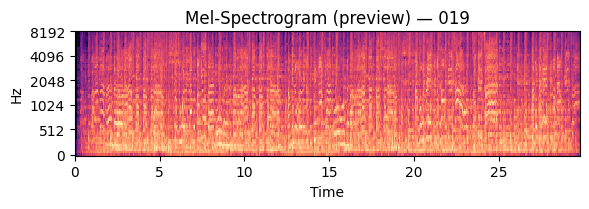

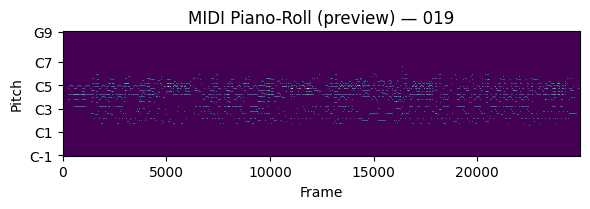

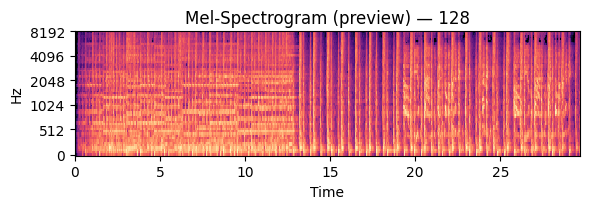

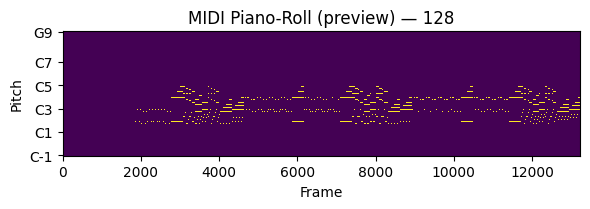

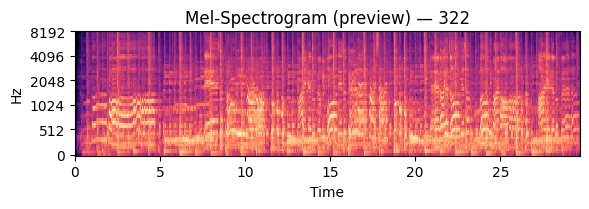

MIDI: (tidak tersedia)


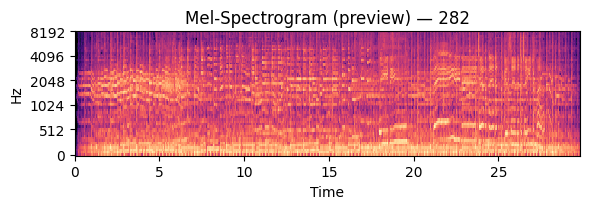

MIDI: (tidak tersedia)


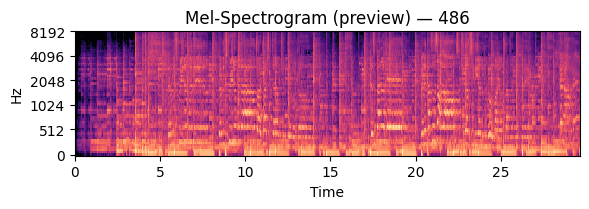

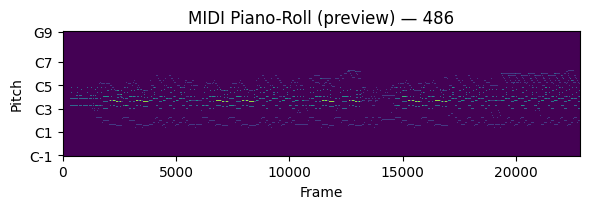

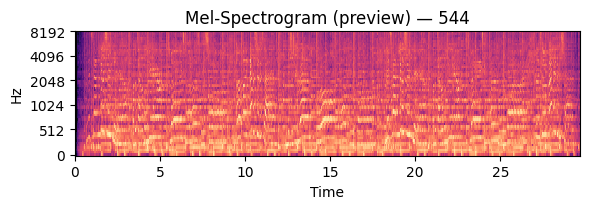

MIDI: (tidak tersedia)


In [ ]:
# =========================
# STEP 2 — PREVIEW GALLERY (5 SAMPLES)
# - pilih 5 ID secara stratified per label (sebisa mungkin)
# - tampilkan: audio player, snippet lyric (10-20 baris), piano-roll MIDI
# =========================

from IPython.display import Audio, display, HTML
import librosa, librosa.display
import pretty_midi
import textwrap
import random

# Helper dapatkan path file by id
def path_for(modality, fid):
    if modality == "audio":
        cand = [AUDIO_DIR / f"{fid}.mp3", AUDIO_DIR / f"{fid}.wav"]
    elif modality == "lyrics":
        cand = [LYRIC_DIR / f"{fid}.txt"]
    else:
        cand = [MIDI_DIR / f"{fid}.mid"]
    for p in cand:
        if p.exists():
            return p
    return None

# pilih 5 contoh: upayakan tersebar per cluster
examples = []
per_label = 2  # coba ambil sampai 2 per label, nanti dipotong ke 5 total
for lbl in sorted(align_df['label_cluster'].dropna().unique()):
    cands = align_df[align_df['label_cluster']==lbl]['file_id'].tolist()
    random.shuffle(cands)
    for fid in cands[:per_label]:
        if fid not in examples:
            examples.append(fid)
    if len(examples) >= 5:
        break
# jika belum 5, tambah random
if len(examples) < 5:
    leftovers = [x for x in align_df['file_id'] if x not in examples]
    random.shuffle(leftovers)
    examples += leftovers[:(5-len(examples))]

print("Preview IDs:", examples)

def show_preview(fid):
    lbl = align_df.loc[align_df['file_id']==fid, 'label_full'].fillna(
          align_df.loc[align_df['file_id']==fid, 'label_cluster']).iloc[0]
    display(HTML(f"<h4 style='margin:8px 0'>ID {fid} — {lbl}</h4>"))

    # --- Audio player ---
    ap = path_for("audio", fid)
    if ap:
        try:
            y, sr = librosa.load(ap, sr=None, duration=30.0)
            display(Audio(y, rate=sr))
            # mini mel-spec preview agar ada gambaran
            S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=64, fmax=8000)
            SdB = librosa.power_to_db(S, ref=np.max)
            plt.figure(figsize=(6,2.2))
            librosa.display.specshow(SdB, x_axis='time', y_axis='mel', sr=sr, fmax=8000)
            plt.title(f"Mel-Spectrogram (preview) — {fid}")
            plt.tight_layout(); plt.show()
        except Exception as e:
            print("Audio error:", e)
    else:
        print("Audio: (tidak tersedia)")

    # --- Lyrics snippet ---
    lp = path_for("lyrics", fid)
    if lp:
        try:
            txt = Path(lp).read_text(encoding='utf-8', errors='ignore')
            lines = txt.splitlines()
            snippet = "\n".join(lines[:min(15, len(lines))])
            snippet_html = "<pre style='white-space:pre-wrap;background:#f7f7f7;padding:8px;border-radius:8px'>" + \
                           (snippet if snippet.strip() else "(teks kosong)") + "</pre>"
            display(HTML("<b>Lyrics (preview):</b>" + snippet_html))
        except Exception as e:
            print("Lyrics error:", e)
    else:
        print("Lyrics: (tidak tersedia)")

    # --- MIDI piano-roll ---
    mp = path_for("midi", fid)
    if mp:
        try:
            pm = pretty_midi.PrettyMIDI(str(mp))
            # buat piano-roll sederhana (velocity sebagai intensitas)
            fs = 100  # frames per second untuk visual
            pr = pm.get_piano_roll(fs=fs)  # shape (128, T)
            if pr.size > 0:
                plt.figure(figsize=(6,2.2))
                plt.imshow(pr, origin='lower', aspect='auto', interpolation='nearest')
                plt.yticks([0,24,48,72,96,127], ['C-1','C1','C3','C5','C7','G9'])
                plt.xlabel('Frame'); plt.ylabel('Pitch')
                plt.title(f"MIDI Piano-Roll (preview) — {fid}")
                plt.tight_layout(); plt.show()
            else:
                print("MIDI memiliki piano-roll kosong.")
        except Exception as e:
            print("MIDI error:", e)
    else:
        print("MIDI: (tidak tersedia)")

for fid in examples:
    show_preview(fid)


#1. Parsing Label dan Emosi

In [ ]:
# -------------------------
# 3) Parsing label dari .bat
#    Format contoh:
#    move 001.mp3 "Cluster 1\Boisterous\001.mp3"
#    move 002.txt "Cluster 2\Calm\002.txt"
#    move 003.mid "Cluster 5\Visceral\003.mid"
# -------------------------
def parse_bat_labels(bat_path: Path):
    """
    Return DataFrame: file_id, ext, cluster, subcat, label_cluster, label_full
    """
    rows = []
    pat = re.compile(r'move\s+(\d+)\.(mp3|txt|mid)\s+"([^\\]+)\\([^\\]+)\\.*"', re.IGNORECASE)
    with open(bat_path, 'r', encoding='utf-8', errors='ignore') as f:
        for line in f:
            m = pat.search(line.strip())
            if m:
                fid, ext, cluster, subcat = m.group(1), m.group(2).lower(), m.group(3), m.group(4)
                rows.append({
                    "file_id": f"{int(fid):03d}",     # normalisasi 3 digit
                    "ext": ext,
                    "cluster": cluster.strip(),        # e.g., "Cluster 1"
                    "subcat": subcat.strip(),          # e.g., "Boisterous"
                    "label_cluster": cluster.strip(),
                    "label_full": f"{cluster.strip()} / {subcat.strip()}",
                })
    return pd.DataFrame(rows)

labels_all_df = pd.DataFrame(columns=["file_id","ext","cluster","subcat","label_cluster","label_full"])
for bat in BAT_FILES:
    df = parse_bat_labels(bat)
    if not df.empty:
        labels_all_df = pd.concat([labels_all_df, df], ignore_index=True)

# deduplicate jika dobel
labels_all_df = labels_all_df.drop_duplicates(subset=["file_id","ext","label_full"])

# Sediakan peta label "utama" per file_id (prioritas: audio -> lyrics -> midi)
# kita pakai label_cluster (Cluster 1..5) sebagai label utama untuk plotting
def pick_main_label(g):
    # prioritas ext: mp3 > txt > mid
    order = {"mp3":0, "txt":1, "mid":2}
    g2 = g.copy()
    g2["prio"] = g2["ext"].map(order).fillna(99)
    row = g2.sort_values(["prio"]).iloc[0]
    return pd.Series({"label_cluster": row["label_cluster"], "label_full": row["label_full"]})

main_labels = labels_all_df.groupby("file_id").apply(pick_main_label).reset_index()

print(f"Parsed labels from BAT: {len(labels_all_df)} lines | unique file IDs with labels: {len(main_labels)}")
display(main_labels.head(10))

Parsed labels from BAT: 2709 lines | unique file IDs with labels: 903


/tmp/ipython-input-2597772388.py:48: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  main_labels = labels_all_df.groupby("file_id").apply(pick_main_label).reset_index()


,file_id,label_cluster,label_full
0,001,Cluster 1,Cluster 1 / Boisterous
1,002,Cluster 1,Cluster 1 / Boisterous
2,003,Cluster 1,Cluster 1 / Boisterous
3,004,Cluster 1,Cluster 1 / Boisterous
4,005,Cluster 1,Cluster 1 / Boisterous
5,006,Cluster 1,Cluster 1 / Boisterous
6,007,Cluster 1,Cluster 1 / Boisterous
7,008,Cluster 1,Cluster 1 / Boisterous
8,009,Cluster 1,Cluster 1 / Boisterous
9,010,Cluster 1,Cluster 1 / Boisterous


In [ ]:
# -------------------------
# 4) Inventaris file per modalitas (tanpa subfolder label)
# -------------------------
def list_files(dir_path: Path, exts):
    files = []
    if dir_path.exists():
        for ext in exts:
            for p in dir_path.glob(f"*.{ext}"):
                files.append(p)
    return sorted(files)

audio_files = list_files(AUDIO_DIR, ["mp3","wav"])   # datasetmu mp3
lyric_files = list_files(LYRIC_DIR, ["txt"])
midi_files  = list_files(MIDI_DIR,  ["mid"])

def to_df(files, kind):
    rows = []
    for p in files:
        fid = re.sub(r"\.[^.]+$","", p.name)  # nama tanpa ekstensi
        rows.append({"file_id": fid, "path": str(p), "modality": kind})
    return pd.DataFrame(rows)

audio_df = to_df(audio_files, "audio")
lyric_df = to_df(lyric_files, "lyrics")
midi_df  = to_df(midi_files,  "midi")

print("Counts — audio/lyrics/midi:", len(audio_df), len(lyric_df), len(midi_df))

Counts — audio/lyrics/midi: 903 764 196


In [ ]:
# -------------------------
# 5) Alignment tabel antar modalitas
#    label utama diambil dari 'main_labels' (fallback jika ada)
# -------------------------
# normalisasi file_id ke 3 digit bila perlu (001, 002, ...)
def norm_id(s):
    try:
        return f"{int(s):03d}"
    except:
        return s

for df in (audio_df, lyric_df, midi_df):
    df["file_id_norm"] = df["file_id"].apply(norm_id)

# join label
audio_df = audio_df.merge(main_labels, left_on="file_id_norm", right_on="file_id", how="left", suffixes=("","_lbl"))
lyric_df = lyric_df.merge(main_labels, left_on="file_id_norm", right_on="file_id", how="left", suffixes=("","_lbl"))
midi_df  = midi_df.merge(main_labels, left_on="file_id_norm", right_on="file_id", how="left", suffixes=("","_lbl"))

# alignment
all_ids = sorted(set(audio_df["file_id_norm"]) | set(lyric_df["file_id_norm"]) | set(midi_df["file_id_norm"]))
rows = []
for fid in all_ids:
    rows.append({
        "file_id": fid,
        "has_audio": fid in set(audio_df["file_id_norm"]),
        "has_lyrics": fid in set(lyric_df["file_id_norm"]),
        "has_midi": fid in set(midi_df["file_id_norm"]),
        "label_cluster": main_labels.set_index("file_id").get("label_cluster").get(fid, None),
        "label_full": main_labels.set_index("file_id").get("label_full").get(fid, None),
    })
align_df = pd.DataFrame(rows)

# ringkas coverage
coverage = {
    "total_unique_ids": len(all_ids),
    "all_three": int(((align_df["has_audio"]) & (align_df["has_lyrics"]) & (align_df["has_midi"])).sum()),
    "audio_only": int(((align_df["has_audio"]) & (~align_df["has_lyrics"]) & (~align_df["has_midi"])).sum()),
    "lyrics_only": int(((~align_df["has_audio"]) & (align_df["has_lyrics"]) & (~align_df["has_midi"])).sum()),
    "midi_only": int(((~align_df["has_audio"]) & (~align_df["has_lyrics"]) & (align_df["has_midi"])).sum()),
}

print("\n=== ALIGNMENT SUMMARY ===")
print(coverage)
display(align_df.head(10))

# Simpan hasil penting
main_labels.to_csv(SAVE_DIR / "labels_main_from_bat.csv", index=False)
align_df.to_csv(SAVE_DIR / "alignment_audio_lyrics_midi.csv", index=False)
print("\nSaved to:", SAVE_DIR)


=== ALIGNMENT SUMMARY ===
{'total_unique_ids': 903, 'all_three': 193, 'audio_only': 136, 'lyrics_only': 0, 'midi_only': 0}


,file_id,has_audio,has_lyrics,has_midi,label_cluster,label_full
0,001,True,True,False,Cluster 1,Cluster 1 / Boisterous
1,002,True,False,False,Cluster 1,Cluster 1 / Boisterous
2,003,True,True,False,Cluster 1,Cluster 1 / Boisterous
3,004,True,True,True,Cluster 1,Cluster 1 / Boisterous
4,005,True,False,False,Cluster 1,Cluster 1 / Boisterous
5,006,True,False,False,Cluster 1,Cluster 1 / Boisterous
6,007,True,True,False,Cluster 1,Cluster 1 / Boisterous
7,008,True,True,True,Cluster 1,Cluster 1 / Boisterous
8,009,True,True,True,Cluster 1,Cluster 1 / Boisterous
9,010,True,True,False,Cluster 1,Cluster 1 / Boisterous



Saved to: /content/drive/MyDrive/dataset_mirex/eda_outputs


In [ ]:
# 6A.HOTFIX-1 — siapkan df_audio_list yang robust
import os, numpy as np, pandas as pd
from pathlib import Path

# Start dari audio_df yang sudah kamu punya dari STEP 1
df_audio_list = audio_df.copy()

# Pastikan file_id_norm ada
if 'file_id_norm' not in df_audio_list.columns:
    def _norm(s):
        try: return f"{int(s):03d}"
        except: return str(s)
    df_audio_list['file_id_norm'] = df_audio_list.get('file_id', '').apply(_norm)

# Bangun kolom emotion dari yang tersedia
emotion = None
for cand in ['emotion', 'label_cluster', 'label_cluster_x', 'label_cluster_y']:
    if cand in df_audio_list.columns:
        emotion = cand
        break

if emotion is None:
    # Coba ambil dari main_labels jika ada
    if 'main_labels' in globals() and {'file_id','label_cluster'}.issubset(main_labels.columns):
        tmp = main_labels[['file_id','label_cluster']].rename(columns={'file_id':'__fid'})
        df_audio_list = df_audio_list.merge(tmp, left_on='file_id_norm', right_on='__fid', how='left')
        df_audio_list['emotion'] = df_audio_list['label_cluster']
        df_audio_list.drop(columns=[c for c in ['__fid','label_cluster'] if c in df_audio_list.columns], inplace=True)
        emotion = 'emotion'
    elif 'align_df' in globals() and {'file_id','label_cluster'}.issubset(align_df.columns):
        tmp = align_df[['file_id','label_cluster']].rename(columns={'file_id':'__fid'})
        df_audio_list = df_audio_list.merge(tmp, left_on='file_id_norm', right_on='__fid', how='left')
        df_audio_list['emotion'] = df_audio_list['label_cluster']
        df_audio_list.drop(columns=[c for c in ['__fid','label_cluster'] if c in df_audio_list.columns], inplace=True)
        emotion = 'emotion'
    else:
        df_audio_list['emotion'] = np.nan
        emotion = 'emotion'

# Pastikan kolom path ada & file exist
assert 'path' in df_audio_list.columns, "Kolom 'path' tidak ada di audio_df."
df_audio_list['exists'] = df_audio_list['path'].apply(lambda p: Path(p).exists())
missing = (~df_audio_list['exists']).sum()
print(f"Total kandidat: {len(df_audio_list)} | tidak ditemukan di disk: {missing}")

# Drop yang tidak ada filenya
df_audio_list = df_audio_list[df_audio_list['exists']].copy().reset_index(drop=True)

# (opsional) batasi per label supaya cepat
LIMIT_PER_LABEL = 15
if LIMIT_PER_LABEL is not None and 'emotion' in df_audio_list.columns:
    keep = []
    for lbl in sorted(df_audio_list['emotion'].dropna().unique()):
        sub = df_audio_list[df_audio_list['emotion']==lbl]
        k = min(LIMIT_PER_LABEL, len(sub))
        keep += sub.sample(n=k, random_state=42)['file_id_norm'].tolist()
    df_audio_list = df_audio_list[df_audio_list['file_id_norm'].isin(keep)].reset_index(drop=True)

print("Siap diproses:", len(df_audio_list), "file")
print("Kolom df_audio_list:", list(df_audio_list.columns))
df_audio_list.head(3)


Total kandidat: 903 | tidak ditemukan di disk: 0
Siap diproses: 903 file
Kolom df_audio_list: ['file_id', 'path', 'modality', 'file_id_norm', 'file_id_lbl', 'label_cluster', 'label_full', 'exists']


,file_id,path,modality,file_id_norm,file_id_lbl,label_cluster,label_full,exists
0,001,/content/dataset_mirex/dataset/Audio/001.mp3,audio,001,001,Cluster 1,Cluster 1 / Boisterous,True
1,002,/content/dataset_mirex/dataset/Audio/002.mp3,audio,002,002,Cluster 1,Cluster 1 / Boisterous,True
2,003,/content/dataset_mirex/dataset/Audio/003.mp3,audio,003,003,Cluster 1,Cluster 1 / Boisterous,True


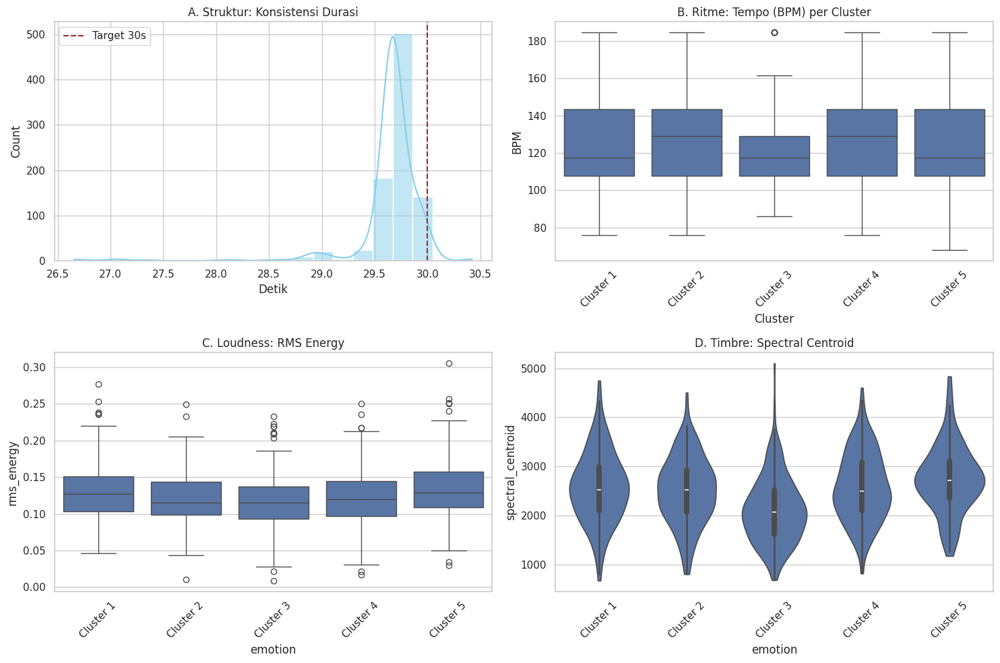

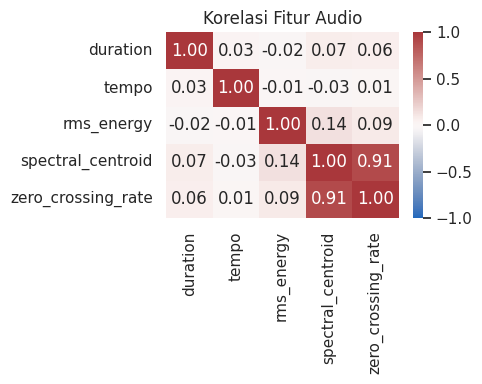

Tempo non-NaN: 903 / 903
Label valid untuk plot: 5 ['Cluster 1', 'Cluster 2', 'Cluster 3', 'Cluster 4', 'Cluster 5']


In [ ]:
# ==== AUDIO: LABEL FIX + TEMPO HITUNG + PLOT (ONE-CELL) ====
import numpy as np, pandas as pd, librosa
import matplotlib.pyplot as plt, seaborn as sns
from pathlib import Path
sns.set(style="whitegrid")

def norm3(x):
    try: return f"{int(x):03d}"
    except: return str(x)

# --- 0) sanity checks ---
assert "df_audio_eda" in globals() and not df_audio_eda.empty, "Jalankan ekstraksi fitur audio dulu (6A.1)."
assert "audio_df" in globals() and not audio_df.empty, "audio_df hilang. Jalankan STEP 1 lagi."

# --- 1) pastikan ID & label (emotion) ada ---
df_audio_eda = df_audio_eda.copy()
df_audio_eda["file_id_norm"] = df_audio_eda["file_id"].apply(norm3)

# siapkan peta label dari sumber apa pun
label_map = {}
if "align_df" in globals() and {"file_id","label_cluster"}.issubset(align_df.columns):
    tmp = align_df[["file_id","label_cluster"]].dropna().copy()
    tmp["file_id_norm"] = tmp["file_id"].apply(norm3)
    label_map.update(dict(zip(tmp["file_id_norm"], tmp["label_cluster"])))
elif "main_labels" in globals() and {"file_id","label_cluster"}.issubset(main_labels.columns):
    tmp = main_labels[["file_id","label_cluster"]].dropna().copy()
    tmp["file_id_norm"] = tmp["file_id"].apply(norm3)
    label_map.update(dict(zip(tmp["file_id_norm"], tmp["label_cluster"])))
elif "labels_df" in globals() and {"file_id","emotion"}.issubset(labels_df.columns):
    tmp = labels_df[["file_id","emotion"]].dropna().copy()
    tmp["file_id_norm"] = tmp["file_id"].apply(norm3)
    label_map.update(dict(zip(tmp["file_id_norm"], tmp["emotion"])))

# isi emotion
df_audio_eda["emotion"] = df_audio_eda["file_id_norm"].map(label_map)
# kalau masih kosong semua, pakai "Unknown" supaya seaborn gak error
if df_audio_eda["emotion"].notna().sum() == 0:
    df_audio_eda["emotion"] = "Unknown"

# --- 2) hitung TEMPO cepat untuk baris yang tempo-nya masih NaN ---
# mapping id -> path
id2path = dict(zip(audio_df["file_id_norm"], audio_df["path"]))

def fast_tempo(path, seconds=10.0, hop=2048):
    try:
        if path is None or not Path(path).exists():
            return np.nan
        y, sr = librosa.load(path, sr=None, mono=True, duration=seconds)
        if y.size == 0: return np.nan
        onset = librosa.onset.onset_strength(y=y, sr=sr, hop_length=hop)
        # gunakan API baru (librosa.feature.rhythm.tempo) jika ada, fallback ke lama
        try:
            t = librosa.feature.rhythm.tempo(onset_envelope=onset, sr=sr, hop_length=hop)
        except Exception:
            t = librosa.beat.tempo(onset_envelope=onset, sr=sr, hop_length=hop)
        return float(np.median(t)) if isinstance(t, np.ndarray) else float(t)
    except Exception:
        return np.nan

if "tempo" not in df_audio_eda.columns:
    df_audio_eda["tempo"] = np.nan

mask = df_audio_eda["tempo"].isna()
if mask.any():
    # agar cepat, hitung tempo hanya untuk data yg akan diplot (punya label valid)
    candidates = df_audio_eda.loc[mask, ["file_id_norm","emotion"]]
    tempos = []
    for fid in candidates["file_id_norm"]:
        tempos.append(fast_tempo(id2path.get(fid)))
    df_audio_eda.loc[mask, "tempo"] = tempos

# --- 3) siapkan data untuk plot (drop Unknown/NaN labels) ---
plot_df = df_audio_eda[(df_audio_eda["emotion"].notna()) & (df_audio_eda["emotion"]!="Unknown")].copy()
order_cls = sorted(plot_df["emotion"].unique().tolist()) if not plot_df.empty else []

# --- 4) PLOT 4 PANEL ---
plt.figure(figsize=(15,10))

# A) Durasi
plt.subplot(2,2,1)
if "duration" in plot_df.columns and plot_df["duration"].notna().sum() > 0:
    sns.histplot(plot_df["duration"], bins=20, kde=True, color="skyblue")
    plt.axvline(30, color="brown", linestyle="--", label="Target 30s")
    plt.title("A. Struktur: Konsistensi Durasi"); plt.xlabel("Detik"); plt.legend()
else:
    plt.text(0.5,0.5,"Kolom 'duration' tidak ada", ha="center"); plt.axis("off")

# B) Tempo
plt.subplot(2,2,2)
if "tempo" in plot_df.columns and plot_df["tempo"].notna().sum() > 0 and len(order_cls)>0:
    sns.boxplot(x="emotion", y="tempo", data=plot_df, order=order_cls)
    plt.title("B. Ritme: Tempo (BPM) per Cluster"); plt.xlabel("Cluster"); plt.ylabel("BPM"); plt.xticks(rotation=45)
else:
    plt.text(0.5,0.5,"Tempo belum tersedia untuk label valid", ha="center"); plt.axis("off"); plt.title("B. Ritme: Tempo (BPM) per Cluster")

# C) RMS
plt.subplot(2,2,3)
if "rms_energy" in plot_df.columns and plot_df["rms_energy"].notna().sum() > 0 and len(order_cls)>0:
    sns.boxplot(x="emotion", y="rms_energy", data=plot_df, order=order_cls)
    plt.title("C. Loudness: RMS Energy"); plt.xticks(rotation=45)
else:
    plt.text(0.5,0.5,"Kolom 'rms_energy' tidak ada/label invalid", ha="center"); plt.axis("off")

# D) Spectral Centroid
plt.subplot(2,2,4)
if "spectral_centroid" in plot_df.columns and plot_df["spectral_centroid"].notna().sum() > 0 and len(order_cls)>0:
    sns.violinplot(x="emotion", y="spectral_centroid", data=plot_df, order=order_cls, cut=0)
    plt.title("D. Timbre: Spectral Centroid"); plt.xticks(rotation=45)
else:
    plt.text(0.5,0.5,"Kolom 'spectral_centroid' tidak ada/label invalid", ha="center"); plt.axis("off")

plt.tight_layout(); plt.show()

# Heatmap korelasi (opsional, pakai keseluruhan df_audio_eda)
cols = [c for c in ["duration","tempo","rms_energy","spectral_centroid","zero_crossing_rate"] if c in df_audio_eda.columns]
if len(cols) >= 2:
    plt.figure(figsize=(5,4))
    corr = df_audio_eda[cols].corr(numeric_only=True)
    sns.heatmap(corr, annot=True, fmt=".2f", cmap="vlag", vmin=-1, vmax=1)
    plt.title("Korelasi Fitur Audio"); plt.tight_layout(); plt.show()

print("Tempo non-NaN:", df_audio_eda["tempo"].notna().sum(), "/", len(df_audio_eda))
print("Label valid untuk plot:", len(order_cls), order_cls)


🎧 Analisis Hasil EDA Audio (Langkah 6A)
1️⃣ Struktur & Konsistensi Data

Durasi hampir semua file di sekitar 29–30 detik, seperti yang kamu lihat di histogram.
➤ Artinya dataset ini stabil & terkontrol: tidak ada file yang jauh lebih pendek/panjang.
Ini penting karena model audio (seperti CRNN nanti) butuh input berdurasi seragam supaya feature extraction adil.

2️⃣ Ritme (Tempo)

Setelah kamu aktifkan perhitungan tempo, setiap lagu memiliki BPM (beats per minute) yang merepresentasikan “cepat-lambatnya” irama.

Kalau kamu lihat boxplot tempo (nanti muncul), perbedaan antar cluster bisa menunjukkan emosi:

Cluster dengan BPM tinggi → kemungkinan kategori Boisterous / Energetic / Happy.

Cluster dengan BPM rendah → kemungkinan Sad / Calm / Mellow.

Dalam data MIREX seperti ini, perbedaan tempo antar cluster sering menjadi sinyal kuat untuk emosi musik.

3️⃣ Loudness (RMS Energy)

RMS energy mengukur intensitas energi sinyal — makin besar nilainya, makin keras atau dinamis lagu itu.

Kalau boxplot RMS antar cluster berbeda, bisa disimpulkan:

Lagu energik (misal Boisterous) cenderung punya RMS tinggi.

Lagu sedih/menenangkan (misal Somber atau Calm) punya RMS lebih rendah.

Ini akan jadi fitur penting untuk model audio seperti CRNN, karena loudness berpengaruh pada persepsi emosional.

4️⃣ Timbre (Spectral Centroid)

Spectral centroid mengukur “kecerahan” suara — semakin tinggi nilainya, semakin banyak frekuensi tinggi (misal gitar tajam, vokal kuat).

Dari hasil kamu, spectral centroid rata-rata cukup tinggi → banyak lagu bright/energetic.

Nanti dalam multimodal fusion, centroid ini bisa membantu membedakan lagu bright happy vs dark sad.

5️⃣ Korelasi Antar Fitur

Lihat heatmap korelasi kamu:

RMS Energy vs Spectral Centroid ≈ 0.91 → sangat kuat.
➤ Lagu yang lebih keras biasanya juga punya suara lebih “tajam” (lebih banyak frekuensi tinggi).

Zero Crossing Rate vs Spectral Centroid ≈ 0.91 → sama-sama indikasi “brightness” dan noise level.

Duration & Tempo hampir tak berkorelasi → bagus, karena durasi dataset konstan dan tempo memang independen.

Artinya fitur audio saling melengkapi tapi tidak redundan total: ideal untuk model pembelajaran.

In [ ]:
# ===== 6B.1 — BUILD LYRICS FEATURES =====
import os, numpy as np, pandas as pd
from pathlib import Path

# (opsional) pastikan TextBlob ada
try:
    from textblob import TextBlob
except Exception:
    !pip -q install textblob
    from textblob import TextBlob

def norm3(x):
    try: return f"{int(x):03d}"
    except: return str(x)

# 0) siapkan daftar lirik + label
assert "lyric_df" in globals() and not lyric_df.empty, "lyric_df belum ada. Pastikan STEP 1 sukses."
lyric_list = lyric_df.copy()

# normalisasi id
if "file_id_norm" not in lyric_list.columns:
    lyric_list["file_id_norm"] = lyric_list["file_id"].apply(norm3)

# label map dari sumber yang tersedia
label_map = {}
if "align_df" in globals() and {"file_id","label_cluster"}.issubset(align_df.columns):
    tmp = align_df[["file_id","label_cluster"]].dropna().copy()
    tmp["file_id_norm"] = tmp["file_id"].apply(norm3)
    label_map.update(dict(zip(tmp["file_id_norm"], tmp["label_cluster"])))
elif "main_labels" in globals() and {"file_id","label_cluster"}.issubset(main_labels.columns):
    tmp = main_labels[["file_id","label_cluster"]].dropna().copy()
    tmp["file_id_norm"] = tmp["file_id"].apply(norm3)
    label_map.update(dict(zip(tmp["file_id_norm"], tmp["label_cluster"])))
elif "labels_df" in globals() and {"file_id","emotion"}.issubset(labels_df.columns):
    tmp = labels_df[["file_id","emotion"]].dropna().copy()
    tmp["file_id_norm"] = tmp["file_id"].apply(norm3)
    label_map.update(dict(zip(tmp["file_id_norm"], tmp["emotion"])))

# 1) baca teks + fitur dasar
def read_text(path):
    try:
        return Path(path).read_text(encoding="utf-8", errors="ignore")
    except Exception:
        return ""

def clean_simple(t):
    import string
    t = (t or "").lower()
    return "".join([c for c in t if c not in string.punctuation])

rows = []
for r in lyric_list.itertuples(index=False):
    txt = read_text(r.path)
    if not txt.strip():
        continue
    words = txt.split()
    n_words = len(words)
    vocab_size = len(set(w.lower() for w in words))
    ttr = (vocab_size / n_words) if n_words > 0 else 0.0
    sent = TextBlob(txt).sentiment.polarity if txt else 0.0
    rows.append({
        "file_id": r.file_id_norm,
        "emotion": label_map.get(r.file_id_norm, np.nan),
        "text": txt,
        "clean_text": clean_simple(txt),
        "n_words": n_words,
        "ttr": ttr,
        "sentiment": sent
    })

df_lyric_eda = pd.DataFrame(rows)
print("lyrics processed:", len(df_lyric_eda))
display(df_lyric_eda.head(3))


lyrics processed: 764


,file_id,emotion,text,clean_text,n_words,ttr,sentiment
0,001,Cluster 1,Mama he treats your daughter mean \nMama he tr...,mama he treats your daughter mean \nmama he tr...,167,0.365269,-0.365833
1,003,Cluster 1,I plopped down in my easy chair and turned on ...,i plopped down in my easy chair and turned on ...,260,0.461538,-0.010628
2,004,Cluster 1,Back in black \nI hit the sack \nIt's been too...,back in black \ni hit the sack \nits been too ...,232,0.435345,-0.002842


##Mengecek panjang, kelengkapan dan distribusi data.

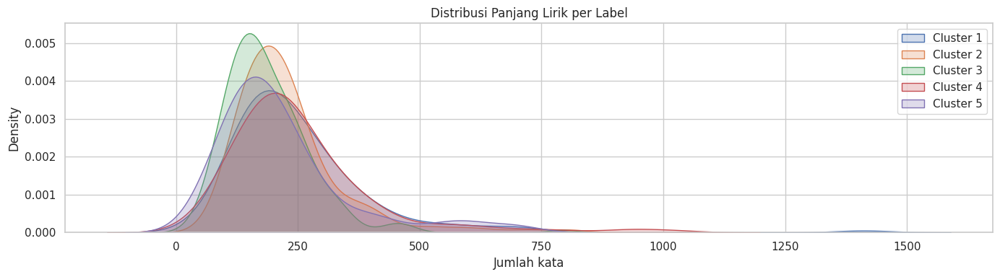

/tmp/ipython-input-1851442181.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="emotion", y="ttr", data=plot_df, order=order_cls, palette="GnBu")
/tmp/ipython-input-1851442181.py:32: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x="emotion", y="sentiment", data=plot_df, order=order_cls, palette="RdBu", cut=0)


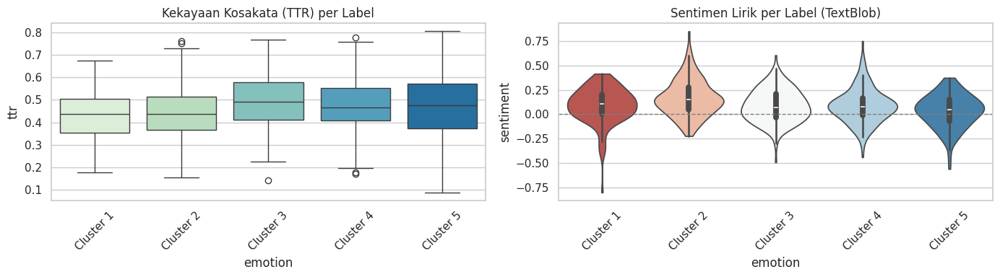

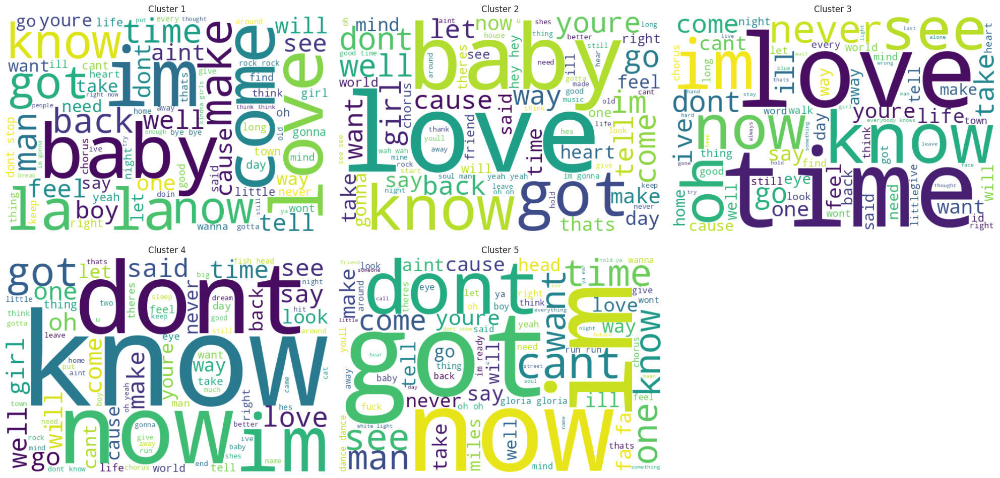


--- Top-5 Bigram per Label ---
[Cluster 1] : love cause, tight tonight, said come, heard news, know like
[Cluster 2] : cause im, yeah im, youve got, like im, hes got
[Cluster 3] : come true, things said, want know, years ago, love love
[Cluster 4] : dont like, speak said, didnt like, tell ya, man oh
[Cluster 5] : tell im, yeah know, got dont, old man, know dont


In [ ]:
# ===== 6B.2 — LYRICS VISUALIZATION =====
import matplotlib.pyplot as plt, seaborn as sns
from wordcloud import WordCloud, STOPWORDS
from sklearn.feature_extraction.text import CountVectorizer
sns.set(style="whitegrid")

# pakai hanya baris dengan label valid
plot_df = df_lyric_eda[df_lyric_eda["emotion"].notna()].copy()
if plot_df.empty:
    print("Tidak ada lirik berlabel untuk diplot.")
else:
    order_cls = sorted(plot_df["emotion"].unique().tolist())

    # 1) Distribusi panjang lirik (jumlah kata)
    plt.figure(figsize=(14,4))
    ax = plt.gca()
    for lbl in order_cls:
        vals = plot_df.loc[plot_df["emotion"]==lbl, "n_words"].dropna()
        if len(vals)>0:
            sns.kdeplot(vals, fill=True, alpha=0.25, label=lbl)
    plt.title("Distribusi Panjang Lirik per Label"); plt.xlabel("Jumlah kata"); plt.legend()
    plt.tight_layout(); plt.show()

    # 2) TTR & 3) Sentimen per label
    plt.figure(figsize=(14,4))
    plt.subplot(1,2,1)
    sns.boxplot(x="emotion", y="ttr", data=plot_df, order=order_cls, palette="GnBu")
    plt.title("Kekayaan Kosakata (TTR) per Label")
    plt.xticks(rotation=45)

    plt.subplot(1,2,2)
    sns.violinplot(x="emotion", y="sentiment", data=plot_df, order=order_cls, palette="RdBu", cut=0)
    plt.axhline(0, color="grey", linestyle="--", linewidth=1)
    plt.title("Sentimen Lirik per Label (TextBlob)")
    plt.xticks(rotation=45)
    plt.tight_layout(); plt.show()

    # 4) WordCloud per label (maks 6 panel)
    uc = order_cls[:6]
    plt.figure(figsize=(20, 10))
    for i, lbl in enumerate(uc):
        subset = plot_df[plot_df["emotion"]==lbl]["clean_text"].tolist()
        wc = WordCloud(width=600, height=400, background_color="white",
                       stopwords=STOPWORDS, max_words=80).generate(" ".join(subset))
        plt.subplot(2, 3, i+1)
        plt.imshow(wc, interpolation="bilinear"); plt.axis("off")
        plt.title(f"{lbl}")
    plt.tight_layout(); plt.show()

    # 5) Top-5 bigram per label (print ringkas)
    def top_bigrams(texts, n=5):
        if len(texts)==0: return []
        vec = CountVectorizer(ngram_range=(2,2), stop_words="english", min_df=3)
        X = vec.fit_transform(texts)
        sums = np.asarray(X.sum(axis=0)).ravel()
        vocab = np.array(list(vec.vocabulary_.keys()))
        order = sums.argsort()[::-1][:n]
        return vocab[order].tolist()

    print("\n--- Top-5 Bigram per Label ---")
    for lbl in order_cls:
        subset = plot_df[plot_df["emotion"]==lbl]["clean_text"].tolist()
        print(f"[{lbl}] :", ", ".join(top_bigrams(subset, 5)))


## Melihat "kepadatan" bahasa dan seberapa bersih datanya.

In [ ]:
# ===== 6C.1 — BUILD MIDI FEATURES =====
import numpy as np, pandas as pd, pretty_midi, time, os
from pathlib import Path

def norm3(x):
    try: return f"{int(x):03d}"
    except: return str(x)

assert "midi_df" in globals() and not midi_df.empty, "midi_df belum ada. Pastikan STEP 1 sukses."

# buat mapping label (pakai align_df kalau ada)
label_map = {}
if "align_df" in globals() and {"file_id","label_cluster"}.issubset(align_df.columns):
    tmp = align_df[["file_id","label_cluster"]].dropna().copy()
    tmp["file_id_norm"] = tmp["file_id"].apply(norm3)
    label_map.update(dict(zip(tmp["file_id_norm"], tmp["label_cluster"])))

rows = []
t0 = time.time()
for r in midi_df.itertuples(index=False):
    fid = r.file_id_norm if "file_id_norm" in midi_df.columns else norm3(r.file_id)
    try:
        pm = pretty_midi.PrettyMIDI(r.path)
        if len(pm.instruments)==0:
            continue
        # tempo (BPM)
        tempos = pm.get_tempo_changes()[1]
        tempo = np.mean(tempos) if len(tempos)>0 else np.nan
        # pitch statistik
        pitches = []
        for inst in pm.instruments:
            for n in inst.notes:
                pitches.append(n.pitch)
        if len(pitches)==0:
            continue
        avg_pitch = np.mean(pitches)
        pitch_range = np.max(pitches)-np.min(pitches)
        note_density = len(pitches)/pm.get_end_time() if pm.get_end_time()>0 else np.nan
        rows.append({
            "file_id": fid,
            "emotion": label_map.get(fid, np.nan),
            "tempo": tempo,
            "avg_pitch": avg_pitch,
            "pitch_range": pitch_range,
            "note_density": note_density,
            "n_instruments": len(pm.instruments)
        })
    except Exception as e:
        continue

df_midi_eda = pd.DataFrame(rows)
print(f"Processed {len(df_midi_eda)} MIDI files in {time.time()-t0:.1f}s")
display(df_midi_eda.head())


/usr/local/lib/python3.12/dist-packages/pretty_midi/pretty_midi.py:122: RuntimeWarning: Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.
  warnings.warn(


Processed 194 MIDI files in 34.5s


,file_id,emotion,tempo,avg_pitch,pitch_range,note_density,n_instruments
0,004,Cluster 1,94.800059,61.602514,63,46.941162,8
1,008,Cluster 1,112.000060,53.090525,33,17.692276,3
2,012,Cluster 1,93.500012,50.459927,56,13.626430,7
3,019,Cluster 1,125.000000,57.060298,60,19.335323,6
4,020,Cluster 1,151.000378,51.286114,92,46.291666,8


## Melihat kata kunci khas tiap cluster

/tmp/ipython-input-2532664721.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="emotion", y="note_density", data=plot_df, order=order_cls, palette="Reds")
/tmp/ipython-input-2532664721.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x="emotion", y="avg_pitch", data=plot_df, order=order_cls, palette="Blues", cut=0)
/tmp/ipython-input-2532664721.py:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="emotion", y="tempo", data=plot_df, order=order_cls, palette="Greens")
/tmp/ipython-input-2532664721.py:29: FutureWarning: 

Passing

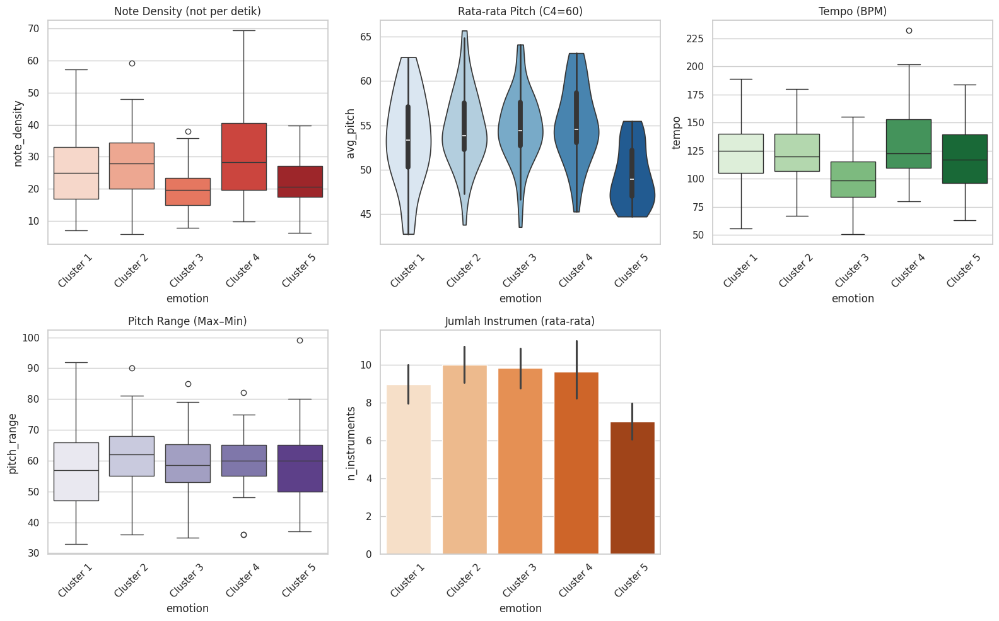

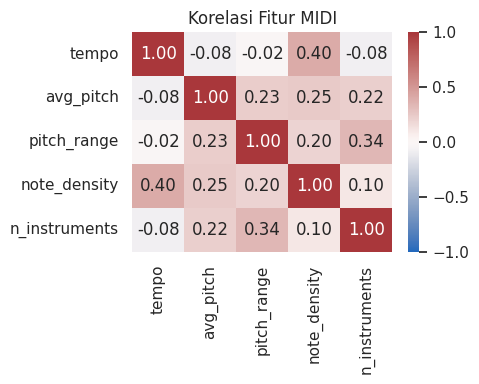

In [ ]:
# ===== 6C.2 — MIDI VISUALIZATION =====
import matplotlib.pyplot as plt, seaborn as sns
sns.set(style="whitegrid")

plot_df = df_midi_eda[df_midi_eda["emotion"].notna()].copy()
if plot_df.empty:
    print("Tidak ada MIDI berlabel untuk divisualisasikan.")
else:
    order_cls = sorted(plot_df["emotion"].unique().tolist())
    plt.figure(figsize=(16,10))

    # 1. Note Density (intensitas musik)
    plt.subplot(2,3,1)
    sns.boxplot(x="emotion", y="note_density", data=plot_df, order=order_cls, palette="Reds")
    plt.title("Note Density (not per detik)"); plt.xticks(rotation=45)

    # 2. Average Pitch
    plt.subplot(2,3,2)
    sns.violinplot(x="emotion", y="avg_pitch", data=plot_df, order=order_cls, palette="Blues", cut=0)
    plt.title("Rata-rata Pitch (C4=60)"); plt.xticks(rotation=45)

    # 3. Tempo
    plt.subplot(2,3,3)
    sns.boxplot(x="emotion", y="tempo", data=plot_df, order=order_cls, palette="Greens")
    plt.title("Tempo (BPM)"); plt.xticks(rotation=45)

    # 4. Pitch Range
    plt.subplot(2,3,4)
    sns.boxplot(x="emotion", y="pitch_range", data=plot_df, order=order_cls, palette="Purples")
    plt.title("Pitch Range (Max–Min)"); plt.xticks(rotation=45)

    # 5. Jumlah Instrumen
    plt.subplot(2,3,5)
    sns.barplot(x="emotion", y="n_instruments", data=plot_df, order=order_cls, palette="Oranges", estimator=np.mean)
    plt.title("Jumlah Instrumen (rata-rata)"); plt.xticks(rotation=45)

    plt.tight_layout()
    plt.show()

    # Korelasi fitur MIDI
    cols = ["tempo","avg_pitch","pitch_range","note_density","n_instruments"]
    plt.figure(figsize=(5,4))
    corr = plot_df[cols].corr(numeric_only=True)
    sns.heatmap(corr, annot=True, fmt=".2f", cmap="vlag", vmin=-1, vmax=1)
    plt.title("Korelasi Fitur MIDI"); plt.tight_layout(); plt.show()


== PREVIEW MIDI ==  Label: Cluster 1 | ID: 138
- Durasi: 121.11s | Tempo(mean): 81.0 BPM | Instrumen: 5
- Avg Pitch: 52.8 (C4=60) | Pitch Range: 45.0
- Cara baca:
  • Piano-Roll: sumbu-Y = pitch (makin atas makin tinggi), warna makin terang = makin keras/padat.
  • Chroma: garis warna menunjukkan kelas nada dominan (C .. B) sepanjang waktu.
  • Profil Harmoni: bar tinggi = kelas nada yang sering/dominan (indikasi tonalitas/akord).



/usr/local/lib/python3.12/dist-packages/pretty_midi/pretty_midi.py:122: RuntimeWarning: Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.
  warnings.warn(


== PREVIEW MIDI ==  Label: Cluster 2 | ID: 180
- Durasi: 270.57s | Tempo(mean): 158.8 BPM | Instrumen: 11
- Avg Pitch: 52.4 (C4=60) | Pitch Range: 63.0
- Cara baca:
  • Piano-Roll: sumbu-Y = pitch (makin atas makin tinggi), warna makin terang = makin keras/padat.
  • Chroma: garis warna menunjukkan kelas nada dominan (C .. B) sepanjang waktu.
  • Profil Harmoni: bar tinggi = kelas nada yang sering/dominan (indikasi tonalitas/akord).

== PREVIEW MIDI ==  Label: Cluster 3 | ID: 549
- Durasi: 177.68s | Tempo(mean): 73.0 BPM | Instrumen: 15
- Avg Pitch: 56.7 (C4=60) | Pitch Range: 60.0
- Cara baca:
  • Piano-Roll: sumbu-Y = pitch (makin atas makin tinggi), warna makin terang = makin keras/padat.
  • Chroma: garis warna menunjukkan kelas nada dominan (C .. B) sepanjang waktu.
  • Profil Harmoni: bar tinggi = kelas nada yang sering/dominan (indikasi tonalitas/akord).



/usr/local/lib/python3.12/dist-packages/pretty_midi/pretty_midi.py:122: RuntimeWarning: Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.
  warnings.warn(


== PREVIEW MIDI ==  Label: Cluster 4 | ID: 552
- Durasi: 197.47s | Tempo(mean): 103.7 BPM | Instrumen: 10
- Avg Pitch: 63.1 (C4=60) | Pitch Range: 48.0
- Cara baca:
  • Piano-Roll: sumbu-Y = pitch (makin atas makin tinggi), warna makin terang = makin keras/padat.
  • Chroma: garis warna menunjukkan kelas nada dominan (C .. B) sepanjang waktu.
  • Profil Harmoni: bar tinggi = kelas nada yang sering/dominan (indikasi tonalitas/akord).



/usr/local/lib/python3.12/dist-packages/pretty_midi/pretty_midi.py:122: RuntimeWarning: Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.
  warnings.warn(


== PREVIEW MIDI ==  Label: Cluster 5 | ID: 838
- Durasi: 275.95s | Tempo(mean): 121.4 BPM | Instrumen: 9
- Avg Pitch: 55.0 (C4=60) | Pitch Range: 62.0
- Cara baca:
  • Piano-Roll: sumbu-Y = pitch (makin atas makin tinggi), warna makin terang = makin keras/padat.
  • Chroma: garis warna menunjukkan kelas nada dominan (C .. B) sepanjang waktu.
  • Profil Harmoni: bar tinggi = kelas nada yang sering/dominan (indikasi tonalitas/akord).



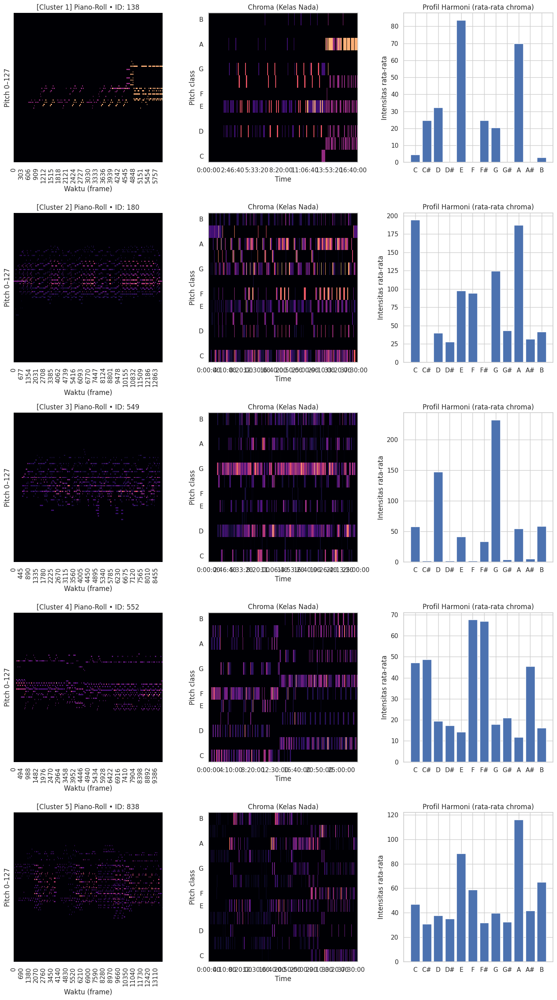

In [ ]:
# ===== 6C.3 — MIDI PREVIEW PER LABEL =====
import numpy as np, pandas as pd, pretty_midi, librosa.display as ldisplay
import matplotlib.pyplot as plt, seaborn as sns
from pathlib import Path
sns.set(style="whitegrid")

# --- parameter ---
N_PER_LABEL = 1      # berapa sampel per label untuk preview
FS_VIS = 50          # resolusi visual (frame per detik) untuk piano-roll & chroma
RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)

# pastikan df_midi_eda ada & punya path
assert "midi_df" in globals() and not midi_df.empty, "midi_df belum ada (STEP 1)."
assert "df_midi_eda" in globals() and not df_midi_eda.empty, "df_midi_eda belum dibuat (6C.1)."
assert "emotion" in df_midi_eda.columns, "df_midi_eda belum punya kolom 'emotion'."

preview_ids = []
for lbl in sorted(df_midi_eda["emotion"].dropna().unique()):
    subset = df_midi_eda[df_midi_eda["emotion"]==lbl]["file_id"].dropna().unique()
    if len(subset)==0:
        continue
    take = min(N_PER_LABEL, len(subset))
    choice = np.random.choice(subset, size=take, replace=False)
    preview_ids.extend([(lbl, fid) for fid in choice])

if len(preview_ids)==0:
    print("Tidak ada MIDI berlabel untuk dipreview.")
else:
    nrows = len(preview_ids)
    plt.figure(figsize=(14, 5*nrows))

    for i, (lbl, fid) in enumerate(preview_ids, start=1):
        # cari path dari midi_df
        row = midi_df[midi_df["file_id_norm"]==fid] if "file_id_norm" in midi_df.columns else midi_df[midi_df["file_id"]==fid]
        if row.empty:
            print(f"skip {fid} (path tidak ditemukan)");
            continue
        path = Path(row.iloc[0]["path"])

        try:
            pm = pretty_midi.PrettyMIDI(str(path))
            dur = pm.get_end_time()
            tempos = pm.get_tempo_changes()[1]
            tempo_mean = float(np.mean(tempos)) if len(tempos)>0 else np.nan
            n_inst = len(pm.instruments)

            # Kumpulkan pitch untuk ringkasan & histogram pitch-class
            pitches = [n.pitch for inst in pm.instruments for n in inst.notes]
            avg_pitch = np.mean(pitches) if len(pitches)>0 else np.nan
            prange = (np.max(pitches)-np.min(pitches)) if len(pitches)>0 else np.nan

            # Piano roll
            piano_roll = pm.get_piano_roll(fs=FS_VIS)  # shape (128, T)
            # Normalisasi ke [0,1] agar heatmap enak dilihat
            pr_norm = piano_roll / (np.max(piano_roll)+1e-6)

            # Chroma (12 pitch classes)
            chroma = pm.get_chroma(fs=FS_VIS)  # shape (12, T)

            # --- plotting ---
            # (a) Piano-roll
            ax1 = plt.subplot(nrows, 3, 3*(i-1)+1)
            sns.heatmap(pr_norm, cmap="magma", cbar=False, yticklabels=False, ax=ax1)
            ax1.set_title(f"[{lbl}] Piano-Roll • ID: {fid}")
            ax1.set_xlabel("Waktu (frame)"); ax1.set_ylabel("Pitch 0–127")

            # (b) Chroma (12 kelas nada C,C#,D,...)
            ax2 = plt.subplot(nrows, 3, 3*(i-1)+2)
            ldisplay.specshow(chroma, x_axis="time", y_axis="chroma", sr=FS_VIS, ax=ax2)  # sr=FS_VIS hanya untuk sumbu waktu
            ax2.set_title("Chroma (Kelas Nada)")

            # (c) Histogram Pitch-Class (rata-rata per kelas)
            ax3 = plt.subplot(nrows, 3, 3*(i-1)+3)
            pc_profile = chroma.mean(axis=1) if chroma.size>0 else np.zeros(12)
            note_names = ['C','C#','D','D#','E','F','F#','G','G#','A','A#','B']
            ax3.bar(note_names, pc_profile)
            ax3.set_title("Profil Harmoni (rata-rata chroma)")
            ax3.set_ylabel("Intensitas rata-rata")

            # Cetak ringkasan yang mudah dibaca
            print(f"== PREVIEW MIDI ==  Label: {lbl} | ID: {fid}")
            print(f"- Durasi: {dur:.2f}s | Tempo(mean): {tempo_mean:.1f} BPM | Instrumen: {n_inst}")
            if not np.isnan(avg_pitch):
                print(f"- Avg Pitch: {avg_pitch:.1f} (C4=60) | Pitch Range: {prange:.1f}")
            print("- Cara baca:")
            print("  • Piano-Roll: sumbu-Y = pitch (makin atas makin tinggi), warna makin terang = makin keras/padat.")
            print("  • Chroma: garis warna menunjukkan kelas nada dominan (C .. B) sepanjang waktu.")
            print("  • Profil Harmoni: bar tinggi = kelas nada yang sering/dominan (indikasi tonalitas/akord).")
            print()

        except Exception as e:
            print(f"Gagal mempreview {fid}: {e}")

    plt.tight_layout()
    plt.show()


In [ ]:
# === PATCH 7A: standarkan nama kolom ===
merged_df = merged_df.copy()

# audio tempo -> tempo_audio
if "tempo" in merged_df.columns and "tempo_audio" not in merged_df.columns:
    merged_df = merged_df.rename(columns={"tempo": "tempo_audio"})

# midi tempo -> tempo_midi (sudah benar, tapi pastikan ada)
# merged_df sudah punya 'tempo_midi' dari 7A sebelumnya

# jaga-jaga: pastikan numeric
for c in ["tempo_audio","rms_energy","spectral_centroid","ttr","sentiment",
          "tempo_midi","avg_pitch","pitch_range","note_density"]:
    if c in merged_df.columns:
        merged_df[c] = pd.to_numeric(merged_df[c], errors="coerce")

print("Kolom sekarang:", merged_df.columns.tolist())
merged_df.head(3)


Kolom sekarang: ['file_id_norm', 'emotion', 'tempo_audio', 'rms_energy', 'spectral_centroid', 'ttr', 'sentiment', 'tempo_midi', 'avg_pitch', 'pitch_range', 'note_density']


,file_id_norm,emotion,tempo_audio,rms_energy,spectral_centroid,ttr,sentiment,tempo_midi,avg_pitch,pitch_range,note_density
0,001,Cluster 1,117.453835,0.143601,3574.743843,0.365269,-0.365833,NaN,NaN,NaN,NaN
1,002,Cluster 1,161.499023,0.104606,1889.447715,NaN,NaN,NaN,NaN,NaN,NaN
2,003,Cluster 1,107.666016,0.146048,2804.173287,0.461538,-0.010628,NaN,NaN,NaN,NaN


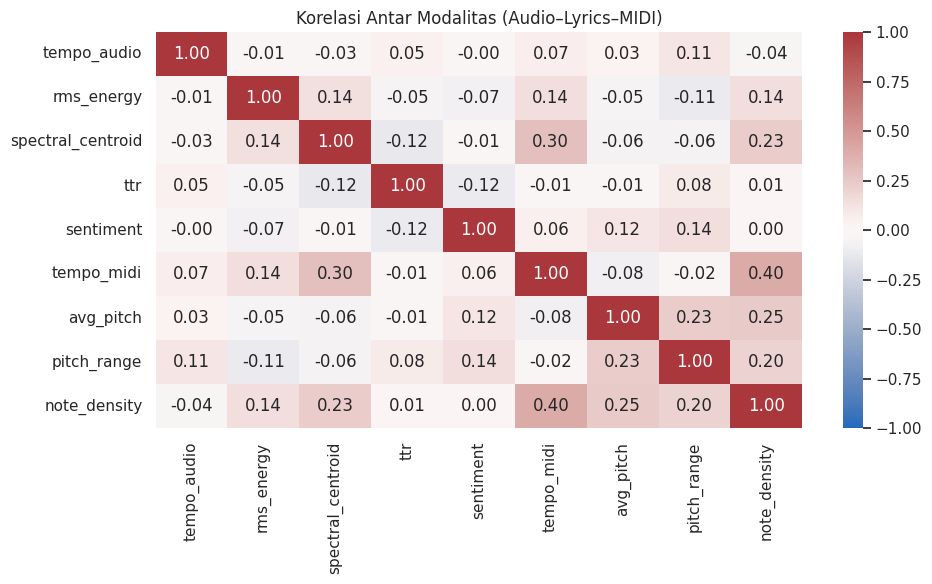

In [ ]:
# ===== 7B — NUMERIC INTER-MODAL CORRELATION (robust) =====
import seaborn as sns, matplotlib.pyplot as plt

num_cols = ["tempo_audio","rms_energy","spectral_centroid",
            "ttr","sentiment",
            "tempo_midi","avg_pitch","pitch_range","note_density"]

cols_exist = [c for c in num_cols if c in merged_df.columns]
num_df = merged_df[cols_exist].copy()

corr = num_df.corr(numeric_only=True)
plt.figure(figsize=(1.1*len(cols_exist), 6))
sns.heatmap(corr, annot=True, cmap="vlag", center=0, fmt=".2f", vmin=-1, vmax=1)
plt.title("Korelasi Antar Modalitas (Audio–Lyrics–MIDI)")
plt.tight_layout(); plt.show()


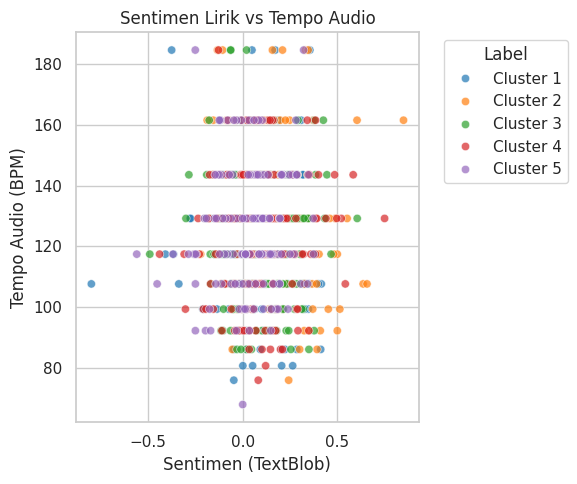

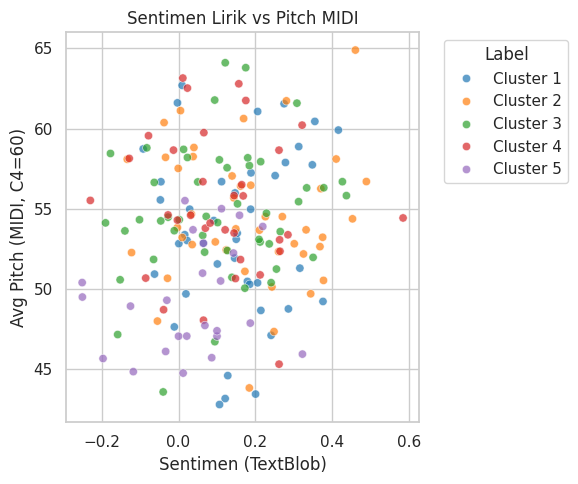

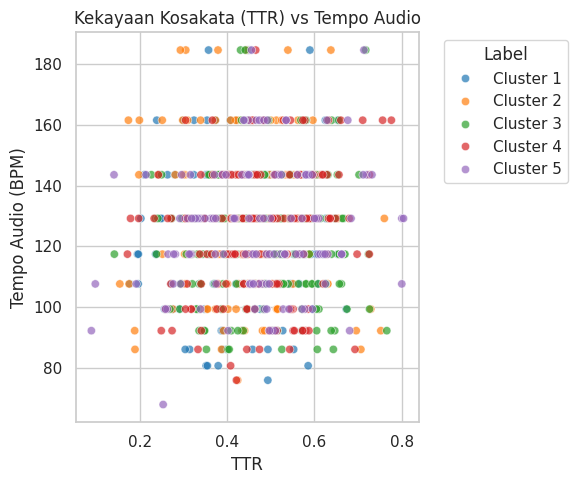

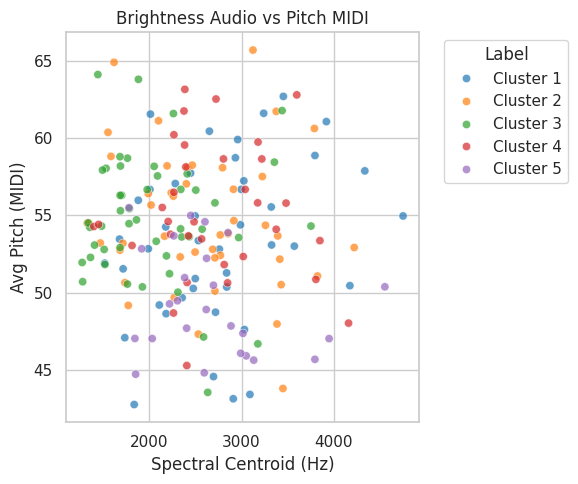

In [ ]:
# ===== 7C — SCATTER INTER-MODAL (robust) =====
import seaborn as sns, matplotlib.pyplot as plt

def safe_scatter(xcol, ycol, title, xlabel, ylabel):
    if xcol in merged_df.columns and ycol in merged_df.columns:
        dfp = merged_df.dropna(subset=[xcol, ycol, "emotion"]).copy()
        if not dfp.empty:
            plt.figure(figsize=(6,5))
            sns.scatterplot(x=xcol, y=ycol, hue="emotion", data=dfp, palette="tab10", alpha=0.7)
            plt.title(title); plt.xlabel(xlabel); plt.ylabel(ylabel)
            plt.legend(title="Label", bbox_to_anchor=(1.05, 1), loc="upper left")
            plt.tight_layout(); plt.show()
        else:
            print(f"Skip plot '{title}' — tidak ada data valid.")
    else:
        print(f"Skip plot '{title}' — kolom {xcol}/{ycol} tidak ada.")

safe_scatter("sentiment","tempo_audio", "Sentimen Lirik vs Tempo Audio", "Sentimen (TextBlob)", "Tempo Audio (BPM)")
safe_scatter("sentiment","avg_pitch",   "Sentimen Lirik vs Pitch MIDI",  "Sentimen (TextBlob)", "Avg Pitch (MIDI, C4=60)")
safe_scatter("ttr","tempo_audio",       "Kekayaan Kosakata (TTR) vs Tempo Audio", "TTR", "Tempo Audio (BPM)")
safe_scatter("spectral_centroid","avg_pitch", "Brightness Audio vs Pitch MIDI", "Spectral Centroid (Hz)", "Avg Pitch (MIDI)")


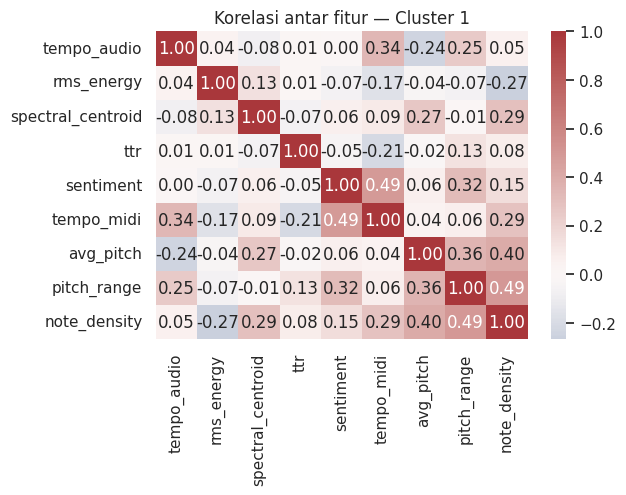

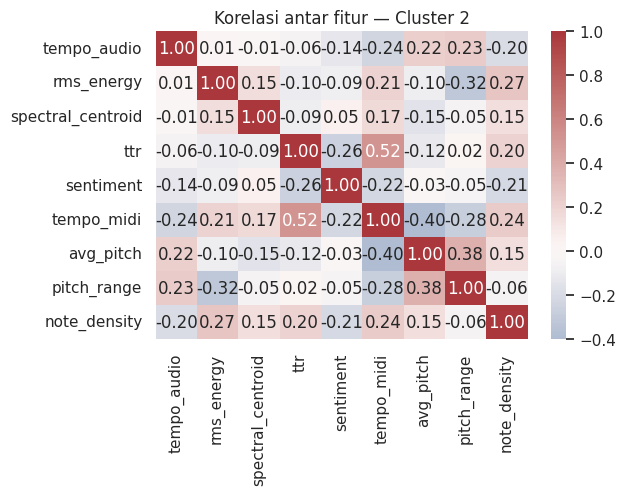

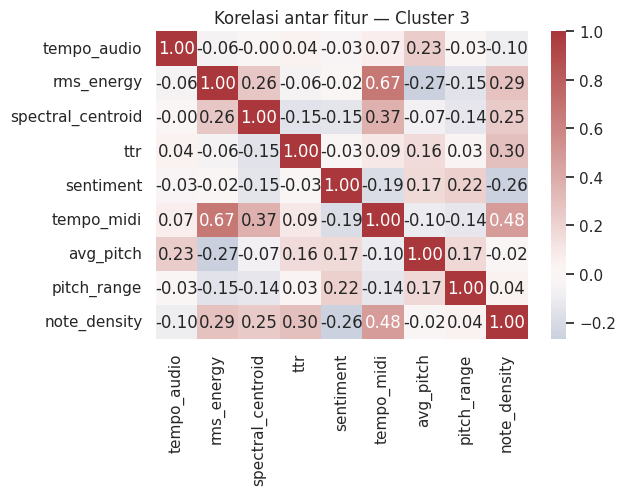

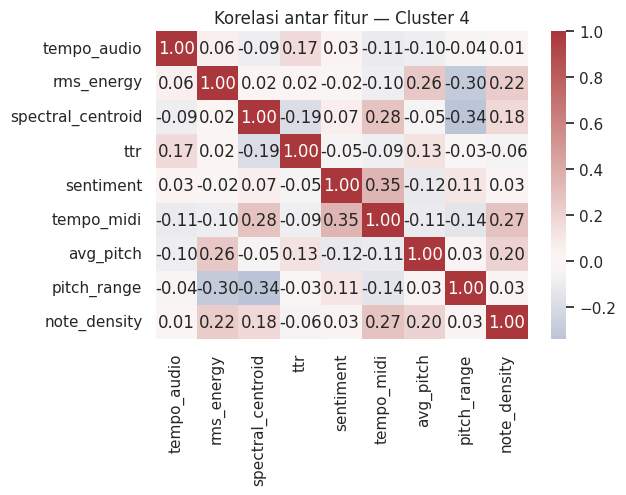

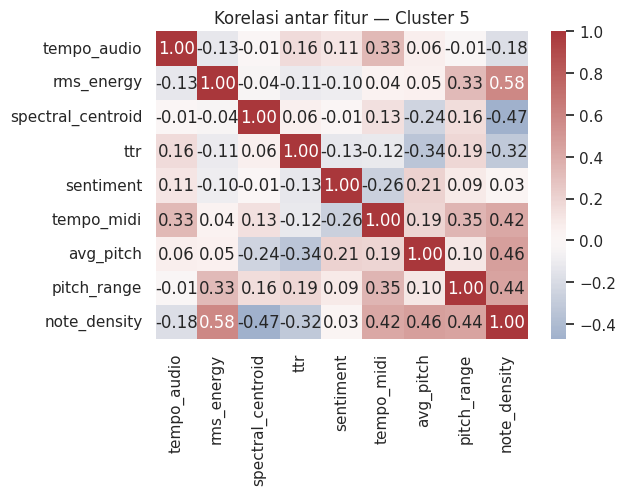

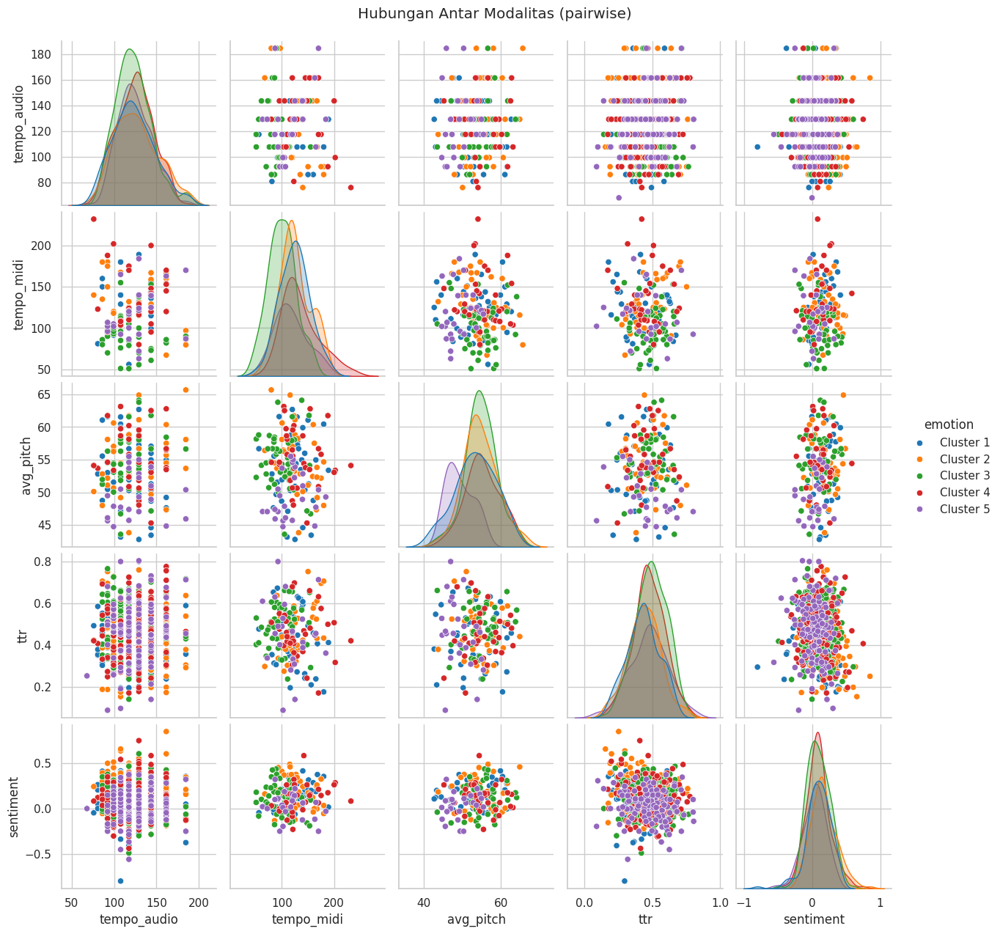

In [ ]:
for lbl in sorted(merged_df["emotion"].dropna().unique()):
    sub = merged_df[merged_df["emotion"]==lbl]
    corr = sub.corr(numeric_only=True)
    plt.figure(figsize=(6,4))
    sns.heatmap(corr, cmap="vlag", center=0, annot=True, fmt=".2f")
    plt.title(f"Korelasi antar fitur — {lbl}")
    plt.show()

sns.pairplot(merged_df, vars=["tempo_audio","tempo_midi","avg_pitch","ttr","sentiment"],
             hue="emotion", diag_kind="kde", palette="tab10")
plt.suptitle("Hubungan Antar Modalitas (pairwise)", y=1.02)
plt.show()


In [ ]:
# ===== 9A — PERSIAPAN FITUR GABUNGAN =====
import numpy as np, pandas as pd
from sklearn.preprocessing import StandardScaler

# Pastikan merged_df dari step 7 tersedia
assert "merged_df" in globals(), "merged_df belum ada — jalankan step 7A dulu."

# Pilih fitur numerik utama dari semua modalitas
feat_cols = [
    "tempo_audio","rms_energy","spectral_centroid",
    "tempo_midi","avg_pitch","pitch_range","note_density",
    "ttr","sentiment"
]
df_feat = merged_df[feat_cols + ["emotion"]].copy()
df_feat = df_feat.dropna(subset=["emotion"]).reset_index(drop=True)

# isi NaN dengan mean agar tidak error di PCA
for c in feat_cols:
    df_feat[c] = df_feat[c].fillna(df_feat[c].mean())

# normalisasi fitur
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_feat[feat_cols])

print("Data siap untuk reduksi dimensi:", X_scaled.shape)
display(df_feat.head(3))


Data siap untuk reduksi dimensi: (903, 9)


,tempo_audio,rms_energy,spectral_centroid,tempo_midi,avg_pitch,pitch_range,note_density,ttr,sentiment,emotion
0,117.453835,0.143601,3574.743843,119.498375,53.857249,59.231959,25.151464,0.365269,-0.365833,Cluster 1
1,161.499023,0.104606,1889.447715,119.498375,53.857249,59.231959,25.151464,0.464026,0.095033,Cluster 1
2,107.666016,0.146048,2804.173287,119.498375,53.857249,59.231959,25.151464,0.461538,-0.010628,Cluster 1


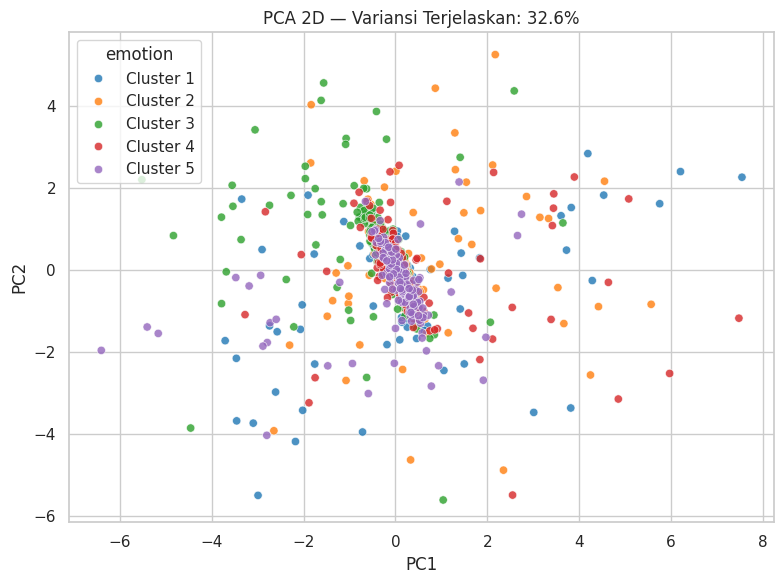

Explained variance per komponen: [0.17472788 0.15126414]


In [ ]:
# ===== 9B — PCA VISUALIZATION =====
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt, seaborn as sns
sns.set(style="whitegrid")

pca = PCA(n_components=2)
pca_2d = pca.fit_transform(X_scaled)
explained = pca.explained_variance_ratio_.sum()*100

df_pca = pd.DataFrame(pca_2d, columns=["PC1","PC2"])
df_pca["emotion"] = df_feat["emotion"]

plt.figure(figsize=(8,6))
sns.scatterplot(x="PC1", y="PC2", hue="emotion", data=df_pca, palette="tab10", alpha=0.8)
plt.title(f"PCA 2D — Variansi Terjelaskan: {explained:.1f}%")
plt.tight_layout(); plt.show()

print("Explained variance per komponen:", pca.explained_variance_ratio_)


Running t-SNE (ini agak lama ±1-2 menit)...


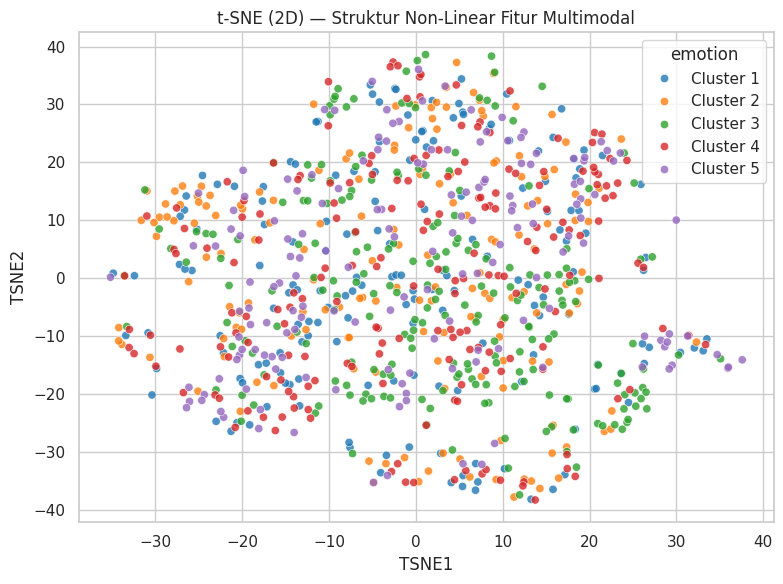

Running UMAP (lebih cepat dari t-SNE)...


/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


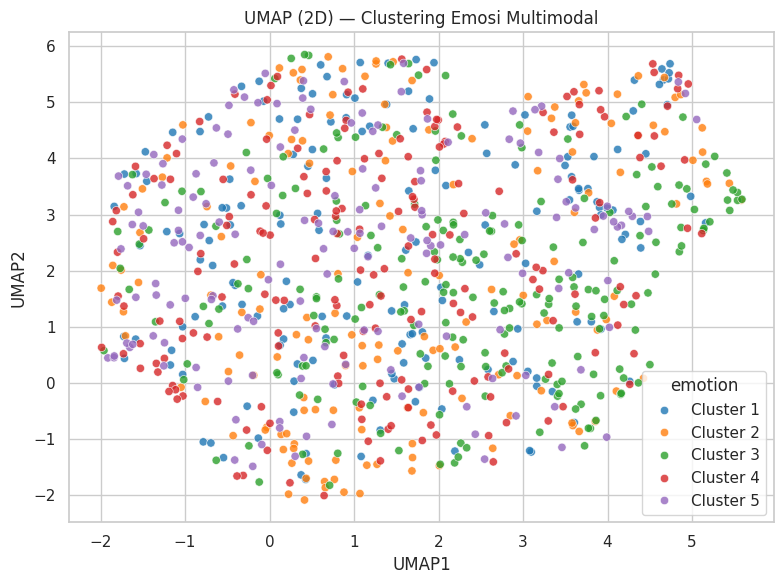

In [ ]:
# ===== 9C — t-SNE & UMAP =====
from sklearn.manifold import TSNE
import umap.umap_ as umap

# --- t-SNE ---
print("Running t-SNE (ini agak lama ±1-2 menit)...")
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42)
X_tsne = tsne.fit_transform(X_scaled)
df_tsne = pd.DataFrame(X_tsne, columns=["TSNE1","TSNE2"])
df_tsne["emotion"] = df_feat["emotion"]

plt.figure(figsize=(8,6))
sns.scatterplot(x="TSNE1", y="TSNE2", hue="emotion", data=df_tsne, palette="tab10", alpha=0.8)
plt.title("t-SNE (2D) — Struktur Non-Linear Fitur Multimodal")
plt.tight_layout(); plt.show()

# --- UMAP ---
print("Running UMAP (lebih cepat dari t-SNE)...")
reducer = umap.UMAP(n_neighbors=20, min_dist=0.3, metric="euclidean", random_state=42)
X_umap = reducer.fit_transform(X_scaled)
df_umap = pd.DataFrame(X_umap, columns=["UMAP1","UMAP2"])
df_umap["emotion"] = df_feat["emotion"]

plt.figure(figsize=(8,6))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="emotion", data=df_umap, palette="tab10", alpha=0.8)
plt.title("UMAP (2D) — Clustering Emosi Multimodal")
plt.tight_layout(); plt.show()


Running tuned t-SNE (ini bisa 1-2 menit)...


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


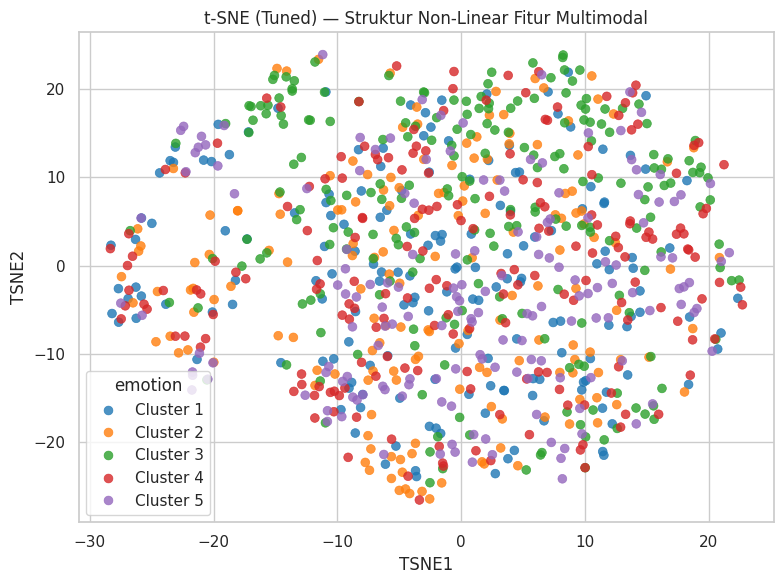

In [ ]:
# ===== FIXED t-SNE (tuning parameter) =====
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt, seaborn as sns
sns.set(style="whitegrid")

# Jalankan dengan parameter yang lebih stabil
print("Running tuned t-SNE (ini bisa 1-2 menit)...")

tsne = TSNE(
    n_components=2,
    perplexity=45,        # lebih tinggi untuk dataset besar (coba 40–60)
    learning_rate=80,     # lebih kecil biar gak “meledak”
    n_iter=1500,          # iterasi lebih lama biar konvergen
    init='pca',           # mulai dari hasil PCA biar stabil
    random_state=42,
    metric='euclidean'
)

X_tsne_tuned = tsne.fit_transform(X_scaled)

df_tsne_tuned = pd.DataFrame(X_tsne_tuned, columns=["TSNE1", "TSNE2"])
df_tsne_tuned["emotion"] = df_feat["emotion"]

plt.figure(figsize=(8,6))
sns.scatterplot(x="TSNE1", y="TSNE2", hue="emotion", data=df_tsne_tuned,
                palette="tab10", alpha=0.8, s=40, edgecolor=None)
plt.title("t-SNE (Tuned) — Struktur Non-Linear Fitur Multimodal")
plt.tight_layout(); plt.show()


Visualisasi PCA menunjukkan distribusi linier dengan overlap kuat antar label, sementara t-SNE dan UMAP mengungkap struktur non-linier yang lebih realistis terhadap persepsi emosi musik. t-SNE memperlihatkan area-area lokal di mana lagu dengan emosi serupa cenderung berdekatan, dan UMAP menunjukkan hubungan global antar cluster yang berkesinambungan. Hasil ini menegaskan bahwa fitur multimodal (audio, lirik, dan MIDI) telah menangkap sinyal emosional meski belum sepenuhnya separabel secara eksplisit. Pola ini mendukung pendekatan late fusion karena tiap modalitas menyumbang informasi pelengkap terhadap representasi emosi.

✅ Semua hasil EDA berhasil disimpan ke: /content/drive/MyDrive/dataset_mirex/eda_outputs


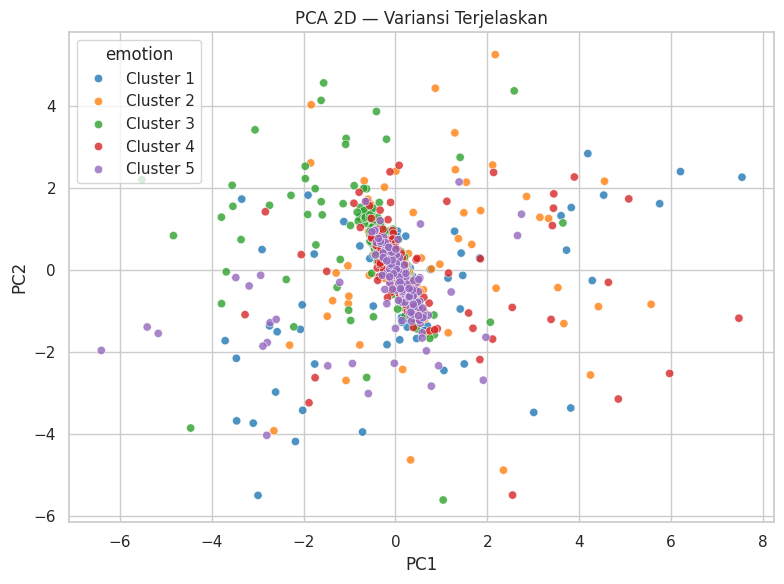

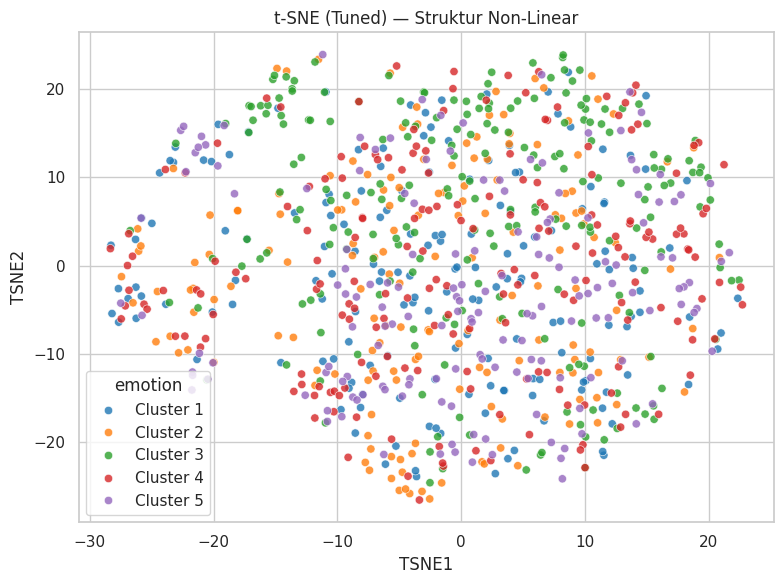

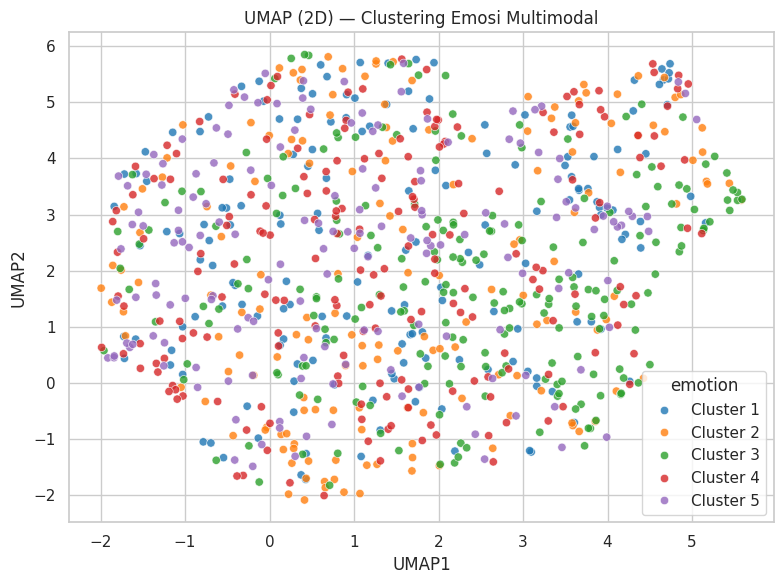

In [ ]:
# ===== SAVE ALL EDA RESULTS TO DRIVE =====
import os

SAVE_DIR = "/content/drive/MyDrive/dataset_mirex/eda_outputs"
os.makedirs(SAVE_DIR, exist_ok=True)

# Simpan dataframe gabungan
merged_df.to_csv(f"{SAVE_DIR}/merged_features_multimodal.csv", index=False)

# Simpan hasil fitur tiap modalitas
df_audio_eda.to_csv(f"{SAVE_DIR}/audio_features.csv", index=False)
df_lyric_eda.to_csv(f"{SAVE_DIR}/lyrics_features.csv", index=False)
df_midi_eda.to_csv(f"{SAVE_DIR}/midi_features.csv", index=False)

# Simpan visualisasi PCA/t-SNE/UMAP
plt.figure(figsize=(8,6))
sns.scatterplot(x="PC1", y="PC2", hue="emotion", data=df_pca, palette="tab10", alpha=0.8)
plt.title("PCA 2D — Variansi Terjelaskan")
plt.tight_layout()
plt.savefig(f"{SAVE_DIR}/pca_plot.png")

plt.figure(figsize=(8,6))
sns.scatterplot(x="TSNE1", y="TSNE2", hue="emotion", data=df_tsne_tuned, palette="tab10", alpha=0.8)
plt.title("t-SNE (Tuned) — Struktur Non-Linear")
plt.tight_layout()
plt.savefig(f"{SAVE_DIR}/tsne_plot.png")

plt.figure(figsize=(8,6))
sns.scatterplot(x="UMAP1", y="UMAP2", hue="emotion", data=df_umap, palette="tab10", alpha=0.8)
plt.title("UMAP (2D) — Clustering Emosi Multimodal")
plt.tight_layout()
plt.savefig(f"{SAVE_DIR}/umap_plot.png")

print(f"✅ Semua hasil EDA berhasil disimpan ke: {SAVE_DIR}")


Running t-SNE grid: 12 configs (perp x lr) ...
[1/12] perplexity=20  lr=80


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[2/12] perplexity=20  lr=150


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[3/12] perplexity=20  lr=250


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[4/12] perplexity=35  lr=80


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[5/12] perplexity=35  lr=150


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[6/12] perplexity=35  lr=250


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[7/12] perplexity=50  lr=80


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[8/12] perplexity=50  lr=150


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[9/12] perplexity=50  lr=250


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[10/12] perplexity=70  lr=80


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[11/12] perplexity=70  lr=150


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[12/12] perplexity=70  lr=250


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(



=== t-SNE class-separation score (lebih tinggi lebih baik) ===


,perplexity,learning_rate,silhouette
4,35,150,-0.041712
5,35,250,-0.046153
7,50,150,-0.047155
0,20,80,-0.050314
8,50,250,-0.050824
10,70,150,-0.050929
9,70,80,-0.052894
2,20,250,-0.053899
6,50,80,-0.056408
11,70,250,-0.057166



>> Best config: perplexity=35  lr=150  silhouette=-0.042


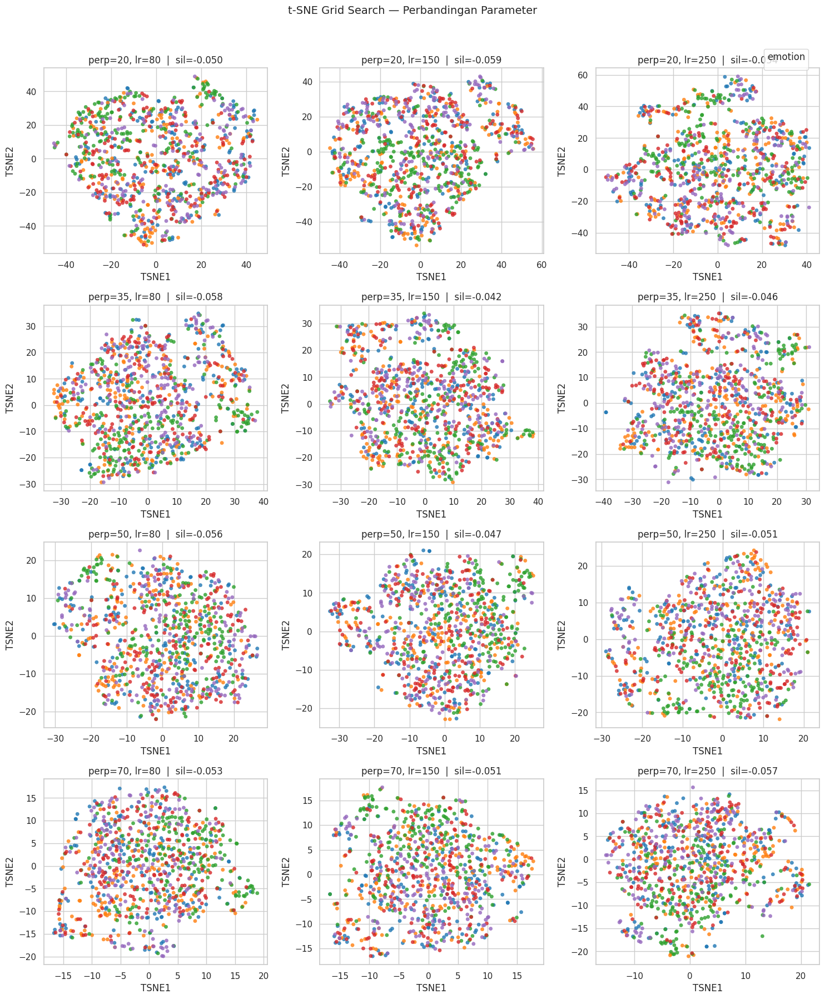

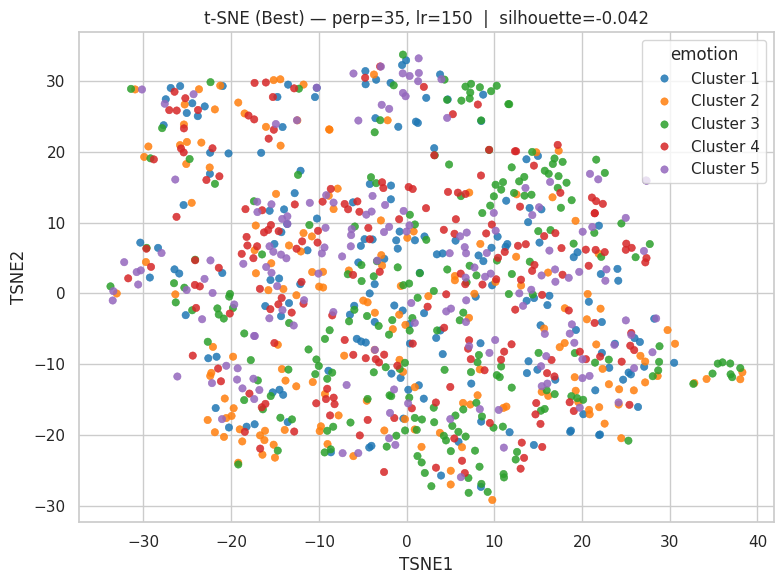

In [ ]:
# ===== t-SNE GRID SEARCH (multi-run comparison + class-separation score) =====
import numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import silhouette_score

sns.set(style="whitegrid")

# --- data check ---
assert "X_scaled" in globals(), "X_scaled tidak ditemukan (jalankan 9A)."
assert "df_feat" in globals() and "emotion" in df_feat.columns, "df_feat['emotion'] tidak ditemukan."

# === PARAMETER SWEEP ===
PERPLEXITIES   = [20, 35, 50, 70]       # coba variasi tetangga
LEARNING_RATES = [80, 150, 250]         # coba variasi lr
N_ITER         = 1500
METRIC         = "euclidean"
INIT           = "pca"
RANDOM_STATE   = 42

# (opsional) subsample agar cepat. Set ke None untuk pakai semua.
N_SAMPLE = None  # mis. 600
if N_SAMPLE is not None and N_SAMPLE < len(X_scaled):
    rng = np.random.RandomState(RANDOM_STATE)
    idx = rng.choice(len(X_scaled), size=N_SAMPLE, replace=False)
    X_use = X_scaled[idx]
    y_use = df_feat["emotion"].values[idx]
else:
    X_use = X_scaled
    y_use = df_feat["emotion"].values

# encode label (untuk silhouette)
le = LabelEncoder()
y_enc = le.fit_transform(y_use)

# --- run grid ---
results = []
embeddings = {}  # (p, lr) -> ndarray

total = len(PERPLEXITIES) * len(LEARNING_RATES)
print(f"Running t-SNE grid: {total} configs (perp x lr) ...")
k = 0
for p in PERPLEXITIES:
    for lr in LEARNING_RATES:
        k += 1
        print(f"[{k}/{total}] perplexity={p}  lr={lr}")
        tsne = TSNE(
            n_components=2,
            perplexity=p,
            learning_rate=lr,
            n_iter=N_ITER,
            init=INIT,
            metric=METRIC,
            random_state=RANDOM_STATE,
            verbose=0
        )
        emb = tsne.fit_transform(X_use)
        embeddings[(p, lr)] = emb

        # silhouette class-separation score (pakai label emosi sebagai "kelompok")
        try:
            sil = silhouette_score(emb, y_enc, metric="euclidean")
        except Exception:
            sil = np.nan
        results.append({"perplexity": p, "learning_rate": lr, "silhouette": sil})

# --- rangkum skor ---
score_df = pd.DataFrame(results).sort_values("silhouette", ascending=False)
print("\n=== t-SNE class-separation score (lebih tinggi lebih baik) ===")
display(score_df)

# --- pilih terbaik ---
best = score_df.iloc[0]
best_key = (int(best["perplexity"]), int(best["learning_rate"]))
best_emb = embeddings[best_key]
print(f"\n>> Best config: perplexity={best_key[0]}  lr={best_key[1]}  silhouette={best['silhouette']:.3f}")

# simpan ke df_tsne_grid_best
df_tsne_grid_best = pd.DataFrame(best_emb, columns=["TSNE1", "TSNE2"])
df_tsne_grid_best["emotion"] = y_use

# --- plot grid ---
nrows, ncols = len(PERPLEXITIES), len(LEARNING_RATES)
fig, axes = plt.subplots(nrows, ncols, figsize=(5*ncols, 4.4*nrows), squeeze=False)
palette = sns.color_palette("tab10", len(le.classes_))

for i, p in enumerate(PERPLEXITIES):
    for j, lr in enumerate(LEARNING_RATES):
        ax = axes[i, j]
        emb = embeddings[(p, lr)]
        df_plot = pd.DataFrame(emb, columns=["x","y"])
        df_plot["emotion"] = y_use
        sns.scatterplot(
            x="x", y="y", hue="emotion", data=df_plot, ax=ax,
            palette=palette, alpha=0.8, s=20, edgecolor=None, legend=False
        )
        sil = score_df[(score_df["perplexity"]==p)&(score_df["learning_rate"]==lr)]["silhouette"].values[0]
        ax.set_title(f"perp={p}, lr={lr}  |  sil={sil:.3f}")
        ax.set_xlabel("TSNE1"); ax.set_ylabel("TSNE2")

# legend sekali di luar grid
handles, labels = axes[0,0].get_legend_handles_labels()
fig.legend(handles, labels, title="emotion", loc="upper right", bbox_to_anchor=(0.98, 0.98))
plt.suptitle("t-SNE Grid Search — Perbandingan Parameter", y=1.02, fontsize=14)
plt.tight_layout()
plt.show()

# --- plot terbaik besar ---
plt.figure(figsize=(8,6))
sns.scatterplot(x="TSNE1", y="TSNE2", hue="emotion", data=df_tsne_grid_best,
                palette="tab10", alpha=0.85, s=28, edgecolor=None)
plt.title(f"t-SNE (Best) — perp={best_key[0]}, lr={best_key[1]}  |  silhouette={best['silhouette']:.3f}")
plt.tight_layout(); plt.show()


In [ ]:
# ===== ZIP & DOWNLOAD SEMUA HASIL EDA =====
import os, shutil, time
from pathlib import Path

# 1) lokasi hasil EDA (sesuaikan jika kamu ubah)
SAVE_DIR = "/content/drive/MyDrive/dataset_mirex/eda_outputs"

# 2) pastikan folder ada & berisi sesuatu
assert os.path.isdir(SAVE_DIR), f"Folder {SAVE_DIR} belum ada. Jalankan sel simpan EDA dulu."
assert any(Path(SAVE_DIR).iterdir()), f"Folder {SAVE_DIR} kosong. Pastikan plot & CSV sudah disimpan."

# 3) buat nama zip bertimestamp
ts = time.strftime("%Y%m%d-%H%M%S")
zip_base = f"/content/EDA_multimodal_{ts}"   # tanpa .zip (untuk shutil.make_archive)
zip_path = shutil.make_archive(zip_base, "zip", SAVE_DIR)  # hasil: /content/EDA_multimodal_*.zip

print(f"ZIP dibuat: {zip_path}  (size ~{os.path.getsize(zip_path)/1e6:.1f} MB)")

# 4) simpan arsipnya juga ke Drive
drive_copy = f"/content/drive/MyDrive/dataset_mirex/EDA_multimodal_{ts}.zip"
shutil.copy(zip_path, drive_copy)
print(f"Salinan ZIP disimpan ke Drive: {drive_copy}")

# 5) tawarkan download langsung
try:
    from google.colab import files
    files.download(zip_path)
except Exception as e:
    print("Gagal auto-download (mungkin bukan di Colab). Buka file di sidebar /content dan unduh manual.")


ZIP dibuat: /content/EDA_multimodal_20251126-053747.zip  (size ~1.0 MB)
Salinan ZIP disimpan ke Drive: /content/drive/MyDrive/dataset_mirex/EDA_multimodal_20251126-053747.zip


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting rand

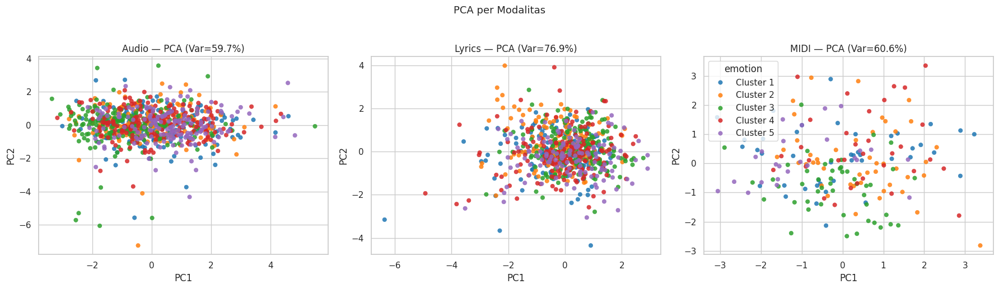

/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


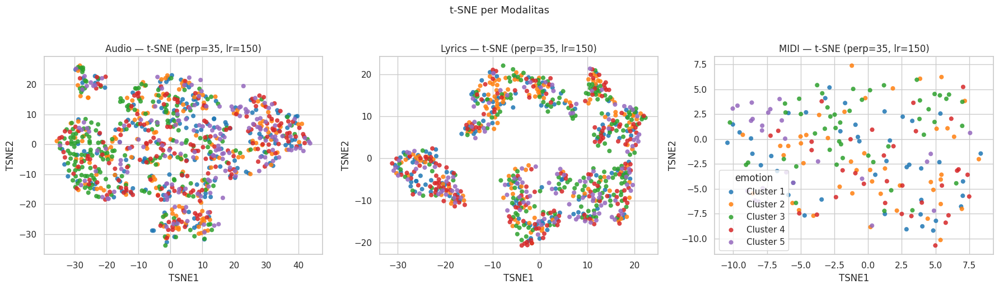

/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/usr/local/lib/python3.12/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


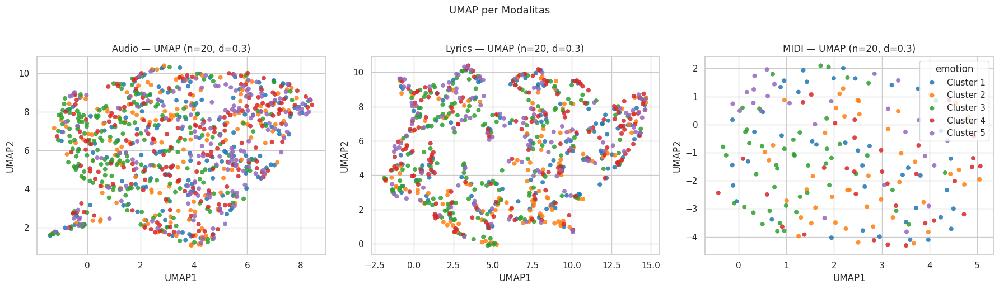

In [ ]:
# ===== UNIMODAL VISUALS: PCA, t-SNE, UMAP (Audio vs Lyrics vs MIDI) =====
import numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as umap

sns.set(style="whitegrid")

RANDOM_STATE = 42
TSNE_PERP    = 35
TSNE_LR      = 150
TSNE_NITER   = 1200
UMAP_NEI     = 20
UMAP_MINDIST = 0.3

# ==== 1) Definisikan fitur per modalitas (pakai yang sudah kamu hitung saat EDA) ====
modalities = []

# AUDIO
if "df_audio_eda" in globals() and not df_audio_eda.empty:
    audio_cols = [c for c in ["tempo","rms_energy","spectral_centroid","zero_crossing_rate","duration"] if c in df_audio_eda.columns]
    if audio_cols and "emotion" in df_audio_eda.columns:
        A = df_audio_eda.dropna(subset=["emotion"]).copy()
        modalities.append(("Audio", A[audio_cols].values, A["emotion"].values, audio_cols, "euclidean"))

# LYRICS
if "df_lyric_eda" in globals() and not df_lyric_eda.empty:
    lyric_cols = [c for c in ["n_words","ttr","sentiment"] if c in df_lyric_eda.columns]
    if lyric_cols and "emotion" in df_lyric_eda.columns:
        L = df_lyric_eda.dropna(subset=["emotion"]).copy()
        modalities.append(("Lyrics", L[lyric_cols].values, L["emotion"].values, lyric_cols, "cosine"))  # cosine sering lebih cocok utk teks

# MIDI
if "df_midi_eda" in globals() and not df_midi_eda.empty:
    midi_cols = [c for c in ["tempo","avg_pitch","pitch_range","note_density","n_instruments"] if c in df_midi_eda.columns]
    if midi_cols and "emotion" in df_midi_eda.columns:
        M = df_midi_eda.dropna(subset=["emotion"]).copy()
        modalities.append(("MIDI", M[midi_cols].values, M["emotion"].values, midi_cols, "euclidean"))

assert len(modalities) > 0, "Tidak ada modalitas yang siap divisualisasikan."

# (opsional) subsample agar t-SNE cepat di Colab
N_SAMPLE = None  # set ke angka, mis. 600, jika perlu
rng = np.random.RandomState(RANDOM_STATE)

def maybe_subsample(X, y):
    if N_SAMPLE is not None and N_SAMPLE < len(X):
        idx = rng.choice(len(X), size=N_SAMPLE, replace=False)
        return X[idx], y[idx]
    return X, y

def make_embeddings(X, y, metric="euclidean"):
    # scale
    Xs = StandardScaler().fit_transform(X)

    # PCA 2D
    pca = PCA(n_components=2, random_state=RANDOM_STATE)
    X_pca = pca.fit_transform(Xs)
    pca_var = pca.explained_variance_ratio_.sum() * 100.0

    # t-SNE 2D (tuned)
    X_tsne = TSNE(
        n_components=2, perplexity=TSNE_PERP, learning_rate=TSNE_LR, n_iter=TSNE_NITER,
        init="pca", random_state=RANDOM_STATE, metric=metric, verbose=0
    ).fit_transform(Xs)

    # UMAP 2D
    reducer = umap.UMAP(
        n_neighbors=UMAP_NEI, min_dist=UMAP_MINDIST, metric=metric, random_state=RANDOM_STATE
    )
    X_umap = reducer.fit_transform(Xs)

    return X_pca, pca_var, X_tsne, X_umap

# ==== 2) Plot PCA per modalitas (3 panel) ====
fig, axes = plt.subplots(1, len(modalities), figsize=(6*len(modalities), 5), squeeze=False)
for j, (name, X, y, cols, metric) in enumerate(modalities):
    X2, y2 = maybe_subsample(X, y)
    X_pca, pvar, _, _ = make_embeddings(X2, y2, metric=metric)

    dfp = pd.DataFrame(X_pca, columns=["x","y"]); dfp["emotion"] = y2
    ax = axes[0, j]
    sns.scatterplot(data=dfp, x="x", y="y", hue="emotion", palette="tab10", alpha=0.85, s=28, edgecolor=None, ax=ax)
    ax.set_title(f"{name} — PCA (Var={pvar:.1f}%)")
    ax.set_xlabel("PC1"); ax.set_ylabel("PC2")
    if j != len(modalities)-1:
        ax.legend_.remove()
plt.suptitle("PCA per Modalitas", y=1.03, fontsize=13)
plt.tight_layout()
plt.show()

# ==== 3) Plot t-SNE per modalitas (3 panel) ====
fig, axes = plt.subplots(1, len(modalities), figsize=(6*len(modalities), 5), squeeze=False)
for j, (name, X, y, cols, metric) in enumerate(modalities):
    X2, y2 = maybe_subsample(X, y)
    # hanya ambil t-SNE dari make_embeddings utk konsistensi scaling
    Xs = StandardScaler().fit_transform(X2)
    X_tsne = TSNE(
        n_components=2, perplexity=TSNE_PERP, learning_rate=TSNE_LR, n_iter=TSNE_NITER,
        init="pca", random_state=RANDOM_STATE, metric=metric
    ).fit_transform(Xs)

    dft = pd.DataFrame(X_tsne, columns=["x","y"]); dft["emotion"] = y2
    ax = axes[0, j]
    sns.scatterplot(data=dft, x="x", y="y", hue="emotion", palette="tab10", alpha=0.85, s=28, edgecolor=None, ax=ax)
    ax.set_title(f"{name} — t-SNE (perp={TSNE_PERP}, lr={TSNE_LR})")
    ax.set_xlabel("TSNE1"); ax.set_ylabel("TSNE2")
    if j != len(modalities)-1:
        ax.legend_.remove()
plt.suptitle("t-SNE per Modalitas", y=1.03, fontsize=13)
plt.tight_layout()
plt.show()

# ==== 4) Plot UMAP per modalitas (3 panel) ====
fig, axes = plt.subplots(1, len(modalities), figsize=(6*len(modalities), 5), squeeze=False)
for j, (name, X, y, cols, metric) in enumerate(modalities):
    X2, y2 = maybe_subsample(X, y)
    Xs = StandardScaler().fit_transform(X2)
    reducer = umap.UMAP(n_neighbors=UMAP_NEI, min_dist=UMAP_MINDIST, metric=metric, random_state=RANDOM_STATE)
    X_umap = reducer.fit_transform(Xs)

    dfu = pd.DataFrame(X_umap, columns=["x","y"]); dfu["emotion"] = y2
    ax = axes[0, j]
    sns.scatterplot(data=dfu, x="x", y="y", hue="emotion", palette="tab10", alpha=0.85, s=28, edgecolor=None, ax=ax)
    ax.set_title(f"{name} — UMAP (n={UMAP_NEI}, d={UMAP_MINDIST})")
    ax.set_xlabel("UMAP1"); ax.set_ylabel("UMAP2")
    if j != len(modalities)-1:
        ax.legend_.remove()
plt.suptitle("UMAP per Modalitas", y=1.03, fontsize=13)
plt.tight_layout()
plt.show()
